#  USDA Crops Data Analyzer (USDACDA)

## Version 4 : May 4 2023

### Hossein Sabzian Papi

The purpose of this project is to develop a highly easy-to-use software technology, **USDA Crops Data Analyzer (USDACDA)** for deep exploration of all **USDA survey** data of field crops. This technology is developed to enable the researchers to get the following goals:

1. Fast-query database of all field crops from 2000 to 2022 (1.2 M records).

    Fast integration with map data and high scalability.


2. Easy access to this database by a simple query.


3. Easy analysis of these data at different levels (country, state and county).


4. Easy visualization of these data at different levels (country, state and county.




## Flowchart


This programming project is represented as the following flowchart:







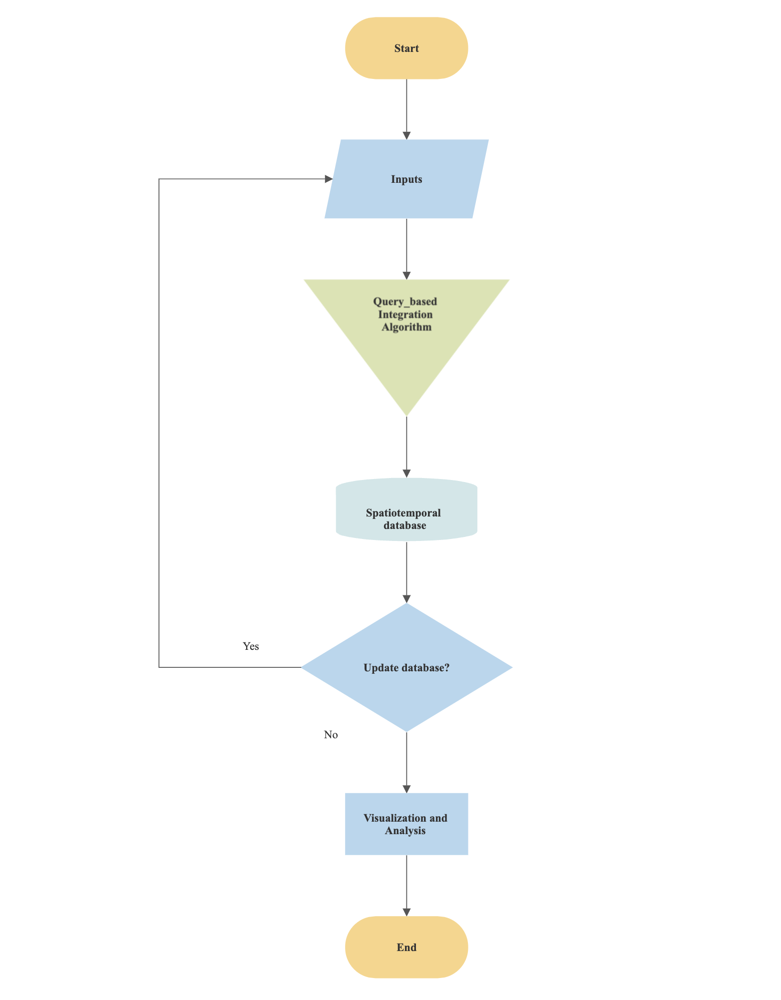

In [2]:
### Modules
import geopandas as gpd
import numpy as np
import pandas as pd
import math
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
import time
import warnings

### 1: Inputs:

 Currently we have the following inputs:
 - 1: Field crops survey data (extracted from https://quickstats.nass.usda.gov/api/)
 
  - A computer program has been developed to gather and integrate USDA surveys in a sigle database(Cloud SQL). 
  - 1283357 records have been integrated so far including ( but not limited to) following items:
  - Commidity: 24 field crops of **['CORN', 'SOYBEANS', 'BARLEY', 'WHEAT', 'RICE', 'OATS', 'SORGHUM',
       'CANOLA', 'FLAXSEED', 'SUNFLOWER', 'COTTON', 'PEANUTS', 'HAY',
       'CHICKPEAS', 'LENTILS', 'PEAS', 'BEANS', 'SUGARBEETS', 'SUGARCANE',
       'TOBACCO', 'MUSTARD', 'SAFFLOWER', 'HAY & HAYLAGE', 'RYE']**
  - Commodity Value.
  - STATEFP.
  - COUNTYFP.
  - Data Item: Planted, Harvested, Production, Yield, .....irrigated, non-irrigated
  - Year: 2000 to 2022
  - ....
 - 2: Map data (extracted from https://www.census.gov/geographies/mapping-files/time-series/geo/carto-boundary-file.html )including( but not limited to) following items:
 
  - spatial reference at county level
  - spatial reference at state level

Note: this database is supposed to be transfered to Google Cloud (Cloud SQL) in near future and all crop data have been currently integrated into a geopandas structure.

In [4]:

##for crop data (Created by a seperate computer programe)
integratedCropData = gpd.read_file('/Users/SABZIAN/Desktop/GIS/FinalProject/FinalProjectReport/integratedCropData.shp')
integratedCropData['COUNTYFP'].fillna('0', inplace = True)

## for US Map (Created by a seperate computer programe), Map is for Contiguous United States.
USMap_edited = gpd.read_file('/Users/SABZIAN/Desktop/GIS/FinalProject/FinalProjectReport/USMap_edited.shp')


In [5]:
## Size of Data
print(f"CropsData has {integratedCropData.shape[0]} records and {integratedCropData.shape[1]} Items ")

CropsData has 1283357 records and 22 Items 


In [6]:
## First 10 rows 
integratedCropData.head(10)


,Program,Year,Period,Week Endin,Geo Level,State,STATEFP,Ag Distric,Ag Distr_1,County,...,Region,watershed_,Watershed,Commodity,Data Item,Domain,Domain Cat,Value,CV (%),geometry
0,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,CORN,CORN - ACRES PLANTED,TOTAL,NOT SPECIFIED,"52,200",00.30,None
1,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,CORN,"CORN, GRAIN - ACRES HARVESTED",TOTAL,NOT SPECIFIED,"48,960",00.60,None
2,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,CORN,"CORN, GRAIN - PRODUCTION, MEASURED IN BU",TOTAL,NOT SPECIFIED,"5,978,300",02.50,None
3,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,CORN,"CORN, GRAIN - YIELD, MEASURED IN BU / ACRE",TOTAL,NOT SPECIFIED,122.1,02.40,None
4,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,SOYBEANS,SOYBEANS - ACRES HARVESTED,TOTAL,NOT SPECIFIED,"57,090",00.80,None
5,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,SOYBEANS,SOYBEANS - ACRES PLANTED,TOTAL,NOT SPECIFIED,"58,800",00.80,None
6,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,SOYBEANS,"SOYBEANS - PRODUCTION, MEASURED IN BU",TOTAL,NOT SPECIFIED,"2,171,600",03.00,None
7,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,NaN,99,OTHER COUNTIES,...,NaN,00000000,NaN,SOYBEANS,"SOYBEANS - YIELD, MEASURED IN BU / ACRE",TOTAL,NOT SPECIFIED,38,02.90,None
8,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,BLACK BELT,40,DALLAS,...,NaN,00000000,NaN,CORN,CORN - ACRES PLANTED,TOTAL,NOT SPECIFIED,"4,700",00.30,None
9,SURVEY,2022,YEAR,NaN,COUNTY,ALABAMA,01,BLACK BELT,40,DALLAS,...,NaN,00000000,NaN,CORN,"CORN, GRAIN - ACRES HARVESTED",TOTAL,NOT SPECIFIED,"4,520",01.10,None


### 2: Query_based Integration algorithm:

This algorithm helps to integrate crop data and map data and return the desired output according to two levels of query (i.e., data items).It must be noted that since number of counties in crops data are less than those of map data (becuse of"other counties" problem existing in USDA survey data), This algorithms helps a lot to tackle this problem.


In [7]:
def Algorithm(cropData, mapData, query_1,query_2 ):
    mapData.rename(columns={'LSAD': 'QUERY'}, inplace=True)

    if len(query_1) > 0 and len(query_2) > 0:
        cropData = cropData[cropData['Data Item'].str.contains(query_1)]
        cropData = cropData[cropData['Data Item'].str.contains(query_2)]
        mapData['QUERY'] = query_1 + "--" + query_2
    elif len(query_1) > 0 and len(query_2) == 0:
        cropData = cropData[cropData['Data Item'].str.contains(query_1)]
        mapData['QUERY'] = query_1
    elif len(query_1) == 0 and len(query_2) > 0:
        cropData = cropData[cropData['Data Item'].str.contains(query_2)]
        mapData['QUERY'] = query_2

    cropData = cropData[['Program', 'Year', 'State', 'STATEFP', 'County', 'COUNTYFP', 'Commodity', 'Data Item', 'Value']]
    Crops_list = []  ## save crops here
    for crop in cropData.Commodity.unique():

        #print(f"Crop is {crop}")  #########################################################################################Crop - Checker 1

        selecetedCrop = cropData[cropData['Commodity'] == crop].copy()  ## Crop is selected

        Years_list = []  ## Maps of country for a typical crop over period of years

        for year in cropData.Year.unique():

            #print(f"Year is {year}")  ################################################################### Year - Checker 2

            # print(selecetedCrop[selecetedCrop['Year'] == year])

            selecetedYear = selecetedCrop[selecetedCrop['Year'] == year].copy()  ## year of crop is selected

            #print("Year selection done")  ################################################################### Selected Year - Checker 3

            MAP = mapData.copy()  ### for each year

            MAPlist_E = gpd.GeoDataFrame()  ### All states maps
            diff_list = []  ## fo saving the difference value between counties in crop data and map data
            Unavailable_list = []  ##for saving those states that dont have the commodity data item in the year

            ################################################################################## Map list of states is made here:
            if selecetedYear.shape[0] > 0:  #### This is a controller and can be removed
                for State_index in range(len(selecetedYear.State.unique())):

                    #print(f"State index is {selecetedYear.State.unique()[State_index]}")  ################################################# State - Checker 4

                    ## state crop selection
                    selectedState = selecetedYear[
                        selecetedYear.State == selecetedYear.State.unique()[State_index]].copy()

                    #print("State selecteion done")

                    ##  select needed items ( it can be moved to pre-processing part)
                    # StateCrop_Se_2 = selectedState[['Program', 'Year', 'State', 'STATEFP', 'County', 'COUNTYFP', 'Commodity', 'Data Item', 'Value']]
                    StateCrop_Se_2 = selectedState.copy()

                    StateCrop_Se = StateCrop_Se_2.copy()

                    #print("Before shape size analysis")  ############################################################################################ Checker 5

                    if StateCrop_Se.shape[0] == 0:  #### This is a controller and can be removed
                        print("into conditional")
                        inf = f"{StateCrop_Se_2.State.values[0]} has no planted {StateCrop_Se_2.Commodity.values[0]} at {StateCrop_Se_2.Year.values[0]}"
                        Unavailable_list.append(inf)

                    else:
                        #print("Statement Block complted")  ##################################################################################################### Checker 6
                        ## 3: the value of crops is string and we change it into float
                        Slice = StateCrop_Se['Value']
                        StateCrop_Se.loc[Slice.index, 'Value'] = StateCrop_Se['Value'].str.replace(',', '')
                        StateCrop_Se.loc[Slice.index, 'Value'] = StateCrop_Se['Value'] = StateCrop_Se['Value'].astype(
                            float)

                        ## 4 : we group all items based on Value ( this is additional and has no effect on data just for confidence)
                        StateCrop_Se_Gr = StateCrop_Se.groupby(
                            ['Program', 'Year', 'State', 'STATEFP', 'County', 'COUNTYFP', 'Commodity', 'Data Item'])[
                            'Value'].sum().reset_index()

                        ####################### Selecting state map of crop

                        ## Step 1: Select the map of state from US Map
                        StateMap = MAP[
                            MAP['STATEFP'] == StateCrop_Se_Gr.STATEFP.values[0]].copy()  ## [ Control point 2]

                        ##################### Integrating state map with state crop

                        if len(StateMap.COUNTYFP.unique()) != len(StateCrop_Se_Gr.COUNTYFP.unique()):
                            inf = f"The difference is {len(StateMap.COUNTYFP.unique()) - len(StateCrop_Se_Gr.COUNTYFP.unique())} for {StateCrop_Se_Gr.State.values[0]} in {StateCrop_Se_Gr.Year.values[0]}"
                            diff_list.append(inf)
                        #else:
                            #print("No difference")

                        StateCrop_Se_Gr.sort_values(by='COUNTYFP',
                                                    inplace=True)  ## sort it based on FIPS codes in ascending manner

                        Value = [0] * StateMap.shape[0]
                        Commodity = [StateCrop_Se_Gr.Commodity.values[0]] * StateMap.shape[0]
                        Year = [StateCrop_Se_Gr.Year.unique()[0]] * StateMap.shape[0]
                        State = [StateCrop_Se_Gr.State.values[0]] * StateMap.shape[0]

                        for i in range(StateMap.shape[0]):  ## 15 items
                            for k in range(StateCrop_Se_Gr.shape[0]):  ## 6 items
                                if StateMap.COUNTYFP.values[i] == StateCrop_Se_Gr.COUNTYFP.values[k]:
                                    Value[i] = StateCrop_Se_Gr.Value.values[k]

                        ## Step 2: make a map for selected crop

                        StateMap.insert(0, 'Value', Value)
                        StateMap.insert(1, 'Commodity', Commodity)
                        StateMap.insert(2, 'Year', Year)
                        StateMap.insert(3, 'State', State)  ### I have added the states in my maps

                        #########################################Final Map list
                        MAPlist_E = MAPlist_E.append(StateMap)
                        ########################################################map list created in this loop

                ## Integration is made if maplist has elemented
                if MAPlist_E.shape[0] > 0:  ## Integration

                    #print("Integration Block started")  ##################################################################################################### Checker 7

                    if len(MAP.columns.to_list()) < len(MAPlist_E.columns.to_list()):
                        Common_items = MAPlist_E.columns.to_list()[4:]  ## this index can be more automated
                        MAP = MAP.merge(MAPlist_E, how='outer', on=Common_items)

                    else:
                        Common_items = MAPlist_E.columns.to_list()
                        MAP = MAP.merge(MAPlist_E, how='outer')

                    if MAP['Commodity'].isna().any():
                        MAP['Commodity'].fillna(MAPlist_E.Commodity.values[0], inplace=True)

                    if MAP['Year'].isna().any():
                        MAP['Year'].fillna(MAPlist_E.Year.values[0], inplace=True)

                    # if StateMap_inUSMapE['State'].isna().any():
                    # StateMap_inUSMapE['State'].fillna(MAPlist[D].State.values[0], inplace=True)

                    if MAP['Value'].isna().any():
                        MAP['Value'].fillna(0, inplace=True)  #### map of country in made

                    Years_list.append(MAP)  ## maps are saved here according to the number of year

        if len(Years_list) > 0:  #### updating crop list
            #print("Crops_list updating block------------------------------------------")  ##################################################################################################### Checker 8
            Crops_list.append(Years_list)
    return Crops_list

### 3: Output (a unified spatiotemporal data structure)

This is a a unified spatiotemporal data structure of M crops over N years where each of its element (E) is a geopnadas structure.


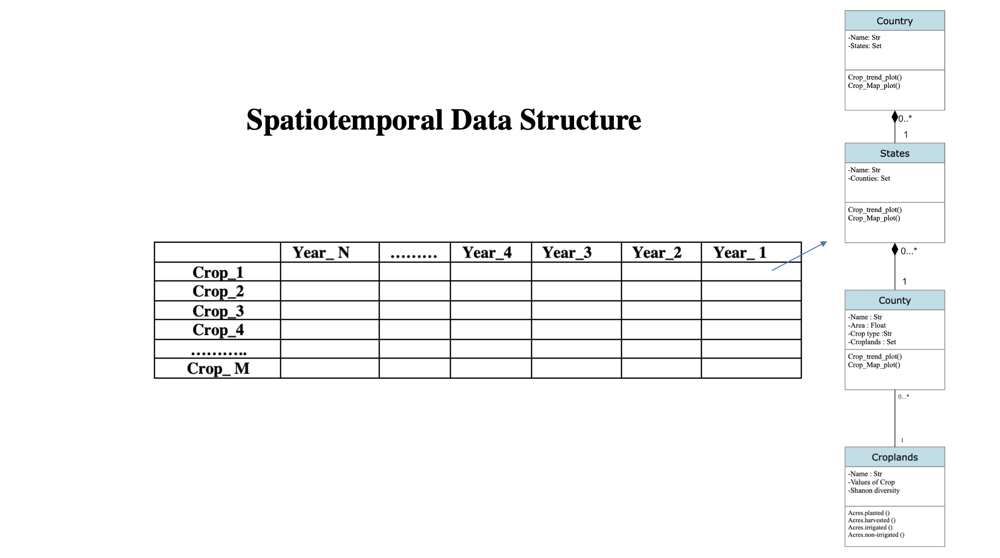


Note 1: T Years are in descending order

Note 2: A basic association relationship is used between cropland and county. 

### Functions for Output analysis and visualization
 1 - plotter: A function for visualizing graphs of all crops (in requested data) over time
 
 2 - cropsepMapper : A function for generating county_level maps of a selected crop in sepetate panels over T years (Normalized)
 
 3- cropmultiMapper : A function for generating county_level maps of a selected crop in a single panel over T years 
 
 4- diversityMapgenerator : A function to compute a diversity Map ( mean type and Shannon ) for requested output over T years
 
 5- diversitysepMapper : A function for generating county_level diversty maps in sepetate panels over T years (Normalized)
 
 6- diversitymultiMapper : A function for generating county_level diversty maps in single panel over T years
 

In [8]:
##1- plotter

def plotter(CROPOUTPUTS):
    TYPE = CROPOUTPUTS[0][0].QUERY.values[0]
    import warnings
    import matplotlib.colors as mcolors
    fig = plt.figure(figsize=(20, 10))
    # Create a list of 50 distinct colors
    color_list = [
        mcolors.to_rgba('red'),
        mcolors.to_rgba('green'),
        mcolors.to_rgba('blue'),
        mcolors.to_rgba('cyan'),
        mcolors.to_rgba('magenta'),
        mcolors.to_rgba('yellow'),
        mcolors.to_rgba('black'),
        mcolors.to_rgba('gray'),
        mcolors.to_rgba('orange'),
        mcolors.to_rgba('brown'),
        mcolors.to_rgba('pink'),
        mcolors.to_rgba('purple'),
        mcolors.to_rgba('teal'),
        mcolors.to_rgba('olive'),
        mcolors.to_rgba('navy'),
        mcolors.to_rgba('maroon'),
        mcolors.to_rgba('turquoise'),
        mcolors.to_rgba('gold'),
        mcolors.to_rgba('orchid'),
        mcolors.to_rgba('plum'),
        mcolors.to_rgba('sienna'),
        mcolors.to_rgba('salmon'),
        mcolors.to_rgba('lime'),
        mcolors.to_rgba('lavender'),
        mcolors.to_rgba('ivory'),
        mcolors.to_rgba('khaki'),
        mcolors.to_rgba('coral'),
        mcolors.to_rgba('tan'),
        mcolors.to_rgba('skyblue'),
        mcolors.to_rgba('crimson'),
        mcolors.to_rgba('indigo'),
        mcolors.to_rgba('seagreen'),
        mcolors.to_rgba('darkorange'),
        mcolors.to_rgba('fuchsia'),
        mcolors.to_rgba('slategray'),
        mcolors.to_rgba('deeppink'),
        mcolors.to_rgba('steelblue'),
        mcolors.to_rgba('limegreen'),
        mcolors.to_rgba('darkviolet'),
        mcolors.to_rgba('forestgreen'),
        mcolors.to_rgba('tomato'),
        mcolors.to_rgba('olivedrab'),
        mcolors.to_rgba('cornflowerblue'),
        mcolors.to_rgba('indianred'),
        mcolors.to_rgba('cadetblue'),
        mcolors.to_rgba('mediumvioletred'),
        mcolors.to_rgba('dodgerblue'),
        mcolors.to_rgba('darkslategray'),
        mcolors.to_rgba('peru'),
        mcolors.to_rgba('teal'),
        mcolors.to_rgba('chocolate')
    ]
    for i in range(len(CROPOUTPUTS)):
        crop_type = CROPOUTPUTS[i]
        crop_name = crop_type[0].Commodity.values[0]
        #print(crop_name)

        time_list = []
        for item in range(len(crop_type)):
            time_list.append(crop_type[item].Year.values[0])

        time_list.reverse()
        #time_list_int = [int(num) for num in time_list]
        time_list_int = time_list
        #print((time_list_int))

        Values_of_crop = []
        for time in range(len(crop_type)):
            Values_of_crop.append(crop_type[time].Value.values.sum())

        with warnings.catch_warnings():
            warnings.simplefilter("ignore")
            plt.plot(time_list_int, np.log(Values_of_crop), color=color_list[i],label=f'{crop_name}') # Use a different color for each crop plot
        #plt.plot(time_list_int, np.log(Values_of_crop), color=color_list[i],label=f'{crop_name}')  # Use a different color for each crop plot
    plt.xlabel('Time')
    plt.ylabel(f'Acres {TYPE} in Log form')
    plt.legend()
    plt.show()

        

In [9]:
##  2- cropsepMapper

def cropsepMapper(CROPOUTPUTS, Crop_index):
    TYPE = CROPOUTPUTS[0][0].QUERY.values[0]
    Selected_crop = CROPOUTPUTS[Crop_index]
    maxValues = []
    for i in range(len(Selected_crop)):
        maxValues.append(Selected_crop[i].Value.values.max())
    for year_index in range(len(Selected_crop)):
        X = CROPOUTPUTS[Crop_index][year_index].copy()  ###### first crop ( changeable)
        import matplotlib.pyplot as plt
        # set the values for vmin and vmax
        vmin, vmax = X["Value"].min(), max(maxValues)  ## Normalizer factor
        # plot the choropleth map
        ax = X.plot(column="Value", cmap="YlGn", linewidth=0.05, edgecolor='black', vmin=vmin, vmax=vmax,
                    figsize=(15, 10))
        # remove the axis labels
        plt.axis("off")
        # add a title to the map
        plt.title(
            f'USMap for {CROPOUTPUTS[Crop_index][year_index].Commodity.values[0]} Crop Level in counties {CROPOUTPUTS[Crop_index][year_index].Year.values[0]}',
            fontsize=5)
        # create the colorbar
        cbar = plt.colorbar(ax.collections[0], fraction=0.03, pad=0.05, aspect=10, label=f"Acres {TYPE} ")
        # set the values in the colorbar manually
        cbar.set_ticks(
            [vmin, (vmax * 0.1), (vmax * 0.2), (vmax * 0.3), (vmax * 0.4), (vmax * 0.5), (vmax * 0.6), (vmax * 0.7),
             (vmax * 0.8), (vmax * 0.9), vmax])
        cbar.set_ticklabels([f"{vmin}",
                             f"< {math.floor(vmax * 0.1)}",
                             f"{math.floor(vmax * 0.1)} - {math.floor(vmax * 0.2)}",
                             f"{math.floor(vmax * 0.2)} - {math.floor(vmax * 0.3)}",
                             f"{math.floor(vmax * 0.3)} - {math.floor(vmax * 0.4)}",
                             f"{math.floor(vmax * 0.4)} - {math.floor(vmax * 0.5)}",
                             f"{math.floor(vmax * 0.5)} - {math.floor(vmax * 0.6)}",
                             f"{math.floor(vmax * 0.6)} - {math.floor(vmax * 0.7)}",
                             f"{math.floor(vmax * 0.7)} - {math.floor(vmax * 0.8)}",
                             f"{math.floor(vmax * 0.8)} - {math.floor(vmax * 0.9)}",
                             f"{vmax * 0.9} - {vmax}"],
                            fontsize=6)
        # show the plot
        plt.show()

In [10]:
## 3- cropmultiMapper
def cropmultiMapper(CROPOUTPUTS, row, col, Crop_index ):
    TYPE = CROPOUTPUTS[0][0].QUERY.values[0]
    fig, axs = plt.subplots(row, col, figsize=(25, 10))
    axs = axs.ravel()
    dataframes = CROPOUTPUTS[Crop_index]  ####  first crop ( changeable)
    # dataframes = V
    for i, X in enumerate(reversed(dataframes)):
        # set the values for vmin and vmax
        vmin, vmax = X["Value"].min(), X["Value"].max()
        # plot the choropleth map
        ax = X.plot(ax=axs[i], column="Value", cmap="YlGn", linewidth=0.05, edgecolor='black', vmin=vmin, vmax=vmax)
        # remove the axis labels
        ax.axis("off")
        # add a title to the map
        # plt.title(f'USMap for {X.Commodity.values[0]} Crop Level in counties {X.Year.values[0]}')

        ax.set_title(f'Map {i + 1} : USMap for {X.Commodity.values[0]} Crop Level in counties {X.Year.values[0]} ',
                     fontsize=5)
        # create the colorbar
        cbar = plt.colorbar(ax.collections[0], ax=axs[i], fraction=0.03, pad=0.05, aspect=10,
                            label=f"Acres {TYPE}")

        # set the values in the colorbar manually
        cbar.set_ticks([vmin, (math.floor(vmax * 0.1)), (math.floor(vmax * 0.2)), (math.floor(vmax * 0.3)),
                        (math.floor(vmax * 0.4)),
                        (math.floor(vmax * 0.5)), (math.floor(vmax * 0.6)), (math.floor(vmax * 0.7)),
                        (math.floor(vmax * 0.8)), (math.floor(vmax * 0.9)), vmax])

        cbar.set_ticklabels([f"{vmin}",
                             f"< {math.floor(vmax * 0.1)}",
                             f"{math.floor(vmax * 0.1)} - {math.floor(vmax * 0.2)}",
                             f"{math.floor(vmax * 0.2)} - {math.floor(vmax * 0.3)}",
                             f"{math.floor(vmax * 0.3)} - {math.floor(vmax * 0.4)}",
                             f"{math.floor(vmax * 0.4)} - {math.floor(vmax * 0.5)}",
                             f"{math.floor(vmax * 0.5)} - {math.floor(vmax * 0.6)}",
                             f"{math.floor(vmax * 0.6)} - {math.floor(vmax * 0.7)}",
                             f"{math.floor(vmax * 0.7)} - {math.floor(vmax * 0.8)}",
                             f"{math.floor(vmax * 0.8)} - {math.floor(vmax * 0.9)}",
                             f"{vmax * 0.9} - {vmax}"],
                            fontsize=6)
    plt.tight_layout()
    plt.show()

In [11]:
##  4- diversityMapgenerator
def diversityMapgenerator(CROPOUTPUTS):
    def COMPLETENESS_CHECKER(CROPOUTPUTS):
        s = 0
        d = len(CROPOUTPUTS)
        for CROP in CROPOUTPUTS:
            s = s + len(CROP)
        if s % d == 0:
            return (True)
        else:
            return (False)
    if COMPLETENESS_CHECKER(CROPOUTPUTS):
        print("It is complete and you can compute the diversity map")
        L = len(CROPOUTPUTS)
        DiversityMap_list = []
        for year_index in range(len(CROPOUTPUTS[0])):
            # year_index = 0
            Crop_values = gpd.GeoDataFrame()
            for crop in range(len(CROPOUTPUTS)):  ## extracting value of each crop
                Crop_values.insert(crop, f'{CROPOUTPUTS[crop][year_index].Commodity.values[0]}',
                                   CROPOUTPUTS[crop][year_index]['Value'])
            #############################  Calculating type_I index
            Crop_values_typeI = Crop_values.copy()

            for items in Crop_values_typeI.columns.to_list():  ## binarization
                for value in range(Crop_values_typeI.shape[0]):
                    if Crop_values_typeI[items][value] > 0:
                        Crop_values_typeI[items][value] = 1

            Mean_values = np.zeros(Crop_values_typeI.shape[0])
            for i in range(Crop_values_typeI.shape[0]):
                for j in range(Crop_values_typeI.shape[1]):
                    Mean_values[i] = Mean_values[i] + Crop_values_typeI.iloc[i][j]

            Mean_values = (Mean_values / Crop_values_typeI.shape[1])  ## Making mean values
            Crop_values_typeI.insert(0, "Mean_values_diversity", Mean_values)  ## adding  it to crop value
            # Omitting unwanted items
            # Crop_values_typeI = Crop_values_typeI.drop(['CORN', 'SOYBEANS', 'BARLEY', 'WHEAT'], 1)
            Crop_values_typeI.drop(columns=Crop_values_typeI.columns[-L:], inplace=True)
            # df.drop(columns=df.columns[-2:], inplace=True)
            ############################# Calculating shanon index
            Crop_values_shanon = Crop_values.copy()

            Total_abundance = np.zeros(Crop_values_shanon.shape[0])  ###  calculating Total abundance
            for i in range(Crop_values_shanon.shape[0]):
                for j in range(Crop_values_shanon.shape[1]):
                    Total_abundance[i] = Total_abundance[i] + Crop_values_shanon.iloc[i][j]
            Crop_values_shanon.insert(0, "Total_abundance", Total_abundance)

            for i in [Crop_values_shanon.columns.to_list()[0]]:  ### dividing crop values on abundance
                for j in Crop_values_shanon.columns.to_list()[1:]:
                    Crop_values_shanon[j] = (Crop_values_shanon[j] / Crop_values_shanon[i])

            for j in Crop_values_shanon.columns.to_list()[1:]:  ## filling nana values
                Crop_values_shanon[j] = Crop_values_shanon[j].fillna(0)

            for j in Crop_values_shanon.columns.to_list()[1:]:  ## making shanon entropy for each crop
                Crop_values_shanon[j] = Crop_values_shanon[j] * np.log(Crop_values_shanon[j])

            for j in Crop_values_shanon.columns.to_list()[1:]:  ## filling nana values agian
                Crop_values_shanon[j] = Crop_values_shanon[j].fillna(0)

            shanon_index = np.zeros(Crop_values_shanon.shape[0])  ###  calculating Total abundance
            for i in range(Crop_values_shanon.shape[0]):
                shanon_index[i] = abs(Crop_values_shanon.iloc[i][1:].sum())
            Crop_values_shanon.insert(0, "shanon_index_diversity", shanon_index)

            ## Omitting unwanted items
            # Crop_values_shanon = Crop_values_shanon.drop(['CORN', 'SOYBEANS', 'BARLEY', 'WHEAT'], 1)
            Crop_values_shanon.drop(columns=Crop_values_shanon.columns[-L:], inplace=True)
            #### Concatenation of Type_I and Shanon and crop values
            DiversityMap = CROPOUTPUTS[0][year_index].copy()
            DiversityMap = DiversityMap.drop(['Value', 'Commodity', 'State'], 1)
            concatenated = pd.concat([DiversityMap, Crop_values_typeI, Crop_values_shanon, Crop_values],
                                     axis=1)  ## concatenating crop values and Map
            # print(type(concatenated))
            # concatenated = concatenated.drop(columns=concatenated.columns[-8:-4], inplace=True)
            DiversityMap = gpd.GeoDataFrame(concatenated, geometry=DiversityMap.geometry)
            # print(type(DiversityMap.shape()))
            # DiversityMap = DiversityMap.drop(columns=DiversityMap.columns[-8:-4], inplace=True)
            DiversityMap_list.append(DiversityMap)
        return DiversityMap_list
    else:
        print("It is non-complete and you can not compute the diversity map")

In [12]:
### 5- diversitysepMapper
def diversitysepMapper(DIVERSITYMAP_LIST,ITEM):
    TYPE = DIVERSITYMAP_LIST[0].QUERY.values[0]
    maxValues = []
    for i in range(len(DiversityMap_list)):
        selectedmap = DiversityMap_list[i]
        maxValues.append(selectedmap[ITEM].values.max())

    for DiverMAp in range(len(DIVERSITYMAP_LIST)):
        X = DIVERSITYMAP_LIST[DiverMAp]
        # set the values for vmin and vmax
        # vmin, vmax = X[index].min(), X[index].max()
        vmin, vmax = X[ITEM].min(), max(maxValues)

        # plot the choropleth map
        ax = X.plot(column=ITEM, cmap="YlGn", linewidth=0.05, edgecolor='black', vmin=vmin, vmax=vmax,figsize=(15, 10))
        # remove the axis labels
        plt.axis("off")
        # add a title to the map
        plt.title(
            f' {ITEM} of {X.iloc[:, 14:].columns.to_list()} for US in {X.Year.values[0]}',fontsize=5
            #f' {ITEM} of {X.columns.to_list()[-4]}, {X.columns.to_list()[-3]},'f'{X.columns.to_list()[-2]},Winter {X.columns.to_list()[-1]} for US in {X.Year.values[0]}', fontsize=5
                  )
        # create the colorbar
        cbar = plt.colorbar(ax.collections[0], fraction=0.03, pad=0.05, aspect=10, label=f"Acres {TYPE}")
        # set the values in the colorbar manually
        cbar.set_ticks(
            [vmin, (vmax * 0.1), (vmax * 0.2), (vmax * 0.3), (vmax * 0.4), (vmax * 0.5), (vmax * 0.6), (vmax * 0.7),
             (vmax * 0.8), (vmax * 0.9), vmax])

        cbar.set_ticklabels([f"{vmin}",
                             f"< {round(vmax * 0.1, 3)}",
                             f"{round(vmax * 0.1, 3)} - {round(vmax * 0.2, 3)}",
                             f"{round(vmax * 0.2, 3)} - {round(vmax * 0.3, 3)}",
                             f"{round(vmax * 0.3, 3)} - {round(vmax * 0.4, 3)}",
                             f"{round(vmax * 0.4, 3)} - {round(vmax * 0.5, 3)}",
                             f"{round(vmax * 0.5, 3)} - {round(vmax * 0.6, 3)}",
                             f"{round(vmax * 0.6, 3)} - {round(vmax * 0.7, 3)}",
                             f"{round(vmax * 0.7, 3)} - {round(vmax * 0.8, 3)}",
                             f"{round(vmax * 0.8, 3)} - {round(vmax * 0.9, 3)}",
                             f"{round(vmax * 0.9, 3)} - {round(vmax, 3)}"],
                            fontsize=6)
        # show the plot
        plt.show()

In [13]:
###  6- diversitymultiMapper
def diversitymultiMapper(DIVERSITYMAP_LIST, ITEM, ROW, COL):
    TYPE = DIVERSITYMAP_LIST[0].QUERY.values[0]
    fig, axs = plt.subplots(ROW, COL, figsize=(25, 10))
    axs = axs.ravel()
    dataframes = DIVERSITYMAP_LIST
    for i, X in enumerate(reversed(dataframes)):
        # set the values for vmin and vmax
        vmin, vmax = X[ITEM].min(), X[ITEM].max()
        # plot the choropleth map
        ax = X.plot(ax=axs[i], column=ITEM, cmap="YlGn", linewidth=0.05, edgecolor='black', vmin=vmin,
                    vmax=vmax)
        # remove the axis labels
        ax.axis("off")
        # add a title to the map
        # plt.title(f'USMap for {X.Commodity.values[0]} Crop Level in counties {X.Year.values[0]}')

        ax.set_title(
            #f' {ITEM} of {X.iloc[:, 14:].columns.to_list()} for US in {X.Year.values[0]}', fontsize=5
            f'Map {i + 1} : USMap of {ITEM} for {X.iloc[:, 14:].columns.to_list()} in {X.Year.values[0]}',
            fontsize=5
            #f'Map {i + 1} : USMap of {ITEM} for {X.columns.to_list()[-4]}, {X.columns.to_list()[-3]},'f'{X.columns.to_list()[-2]},Winter {X.columns.to_list()[-1]} in {X.Year.values[0]}', fontsize=5
                     )
        # create the colorbar
        cbar = plt.colorbar(ax.collections[0], ax=axs[i], fraction=0.03, pad=0.05, aspect=10, label=f"Acres {TYPE}")
        # set the values in the colorbar manually
        cbar.set_ticks(
            [vmin, (vmax * 0.1), (vmax * 0.2), (vmax * 0.3), (vmax * 0.4), (vmax * 0.5), (vmax * 0.6), (vmax * 0.7),
             (vmax * 0.8), (vmax * 0.9), vmax])

        cbar.set_ticklabels([f"{vmin}",
                             f"< {round(vmax * 0.1, 3)}",
                             f"{round(vmax * 0.1, 3)} - {round(vmax * 0.2, 3)}",
                             f"{round(vmax * 0.2, 3)} - {round(vmax * 0.3, 3)}",
                             f"{round(vmax * 0.3, 3)} - {round(vmax * 0.4, 3)}",
                             f"{round(vmax * 0.4, 3)} - {round(vmax * 0.5, 3)}",
                             f"{round(vmax * 0.5, 3)} - {round(vmax * 0.6, 3)}",
                             f"{round(vmax * 0.6, 3)} - {round(vmax * 0.7, 3)}",
                             f"{round(vmax * 0.7, 3)} - {round(vmax * 0.8, 3)}",
                             f"{round(vmax * 0.8, 3)} - {round(vmax * 0.9, 3)}",
                             f"{round(vmax * 0.9, 3)} - {round(vmax, 3)}"],
                            fontsize=6)

    plt.tight_layout()
    plt.show()

# Examples of output analysis by functions

## Example 1: crops based on planted acres query

In [14]:
## Example
import warnings
# Suppress all warnings
warnings.filterwarnings("ignore")

cropOutput_1 = Algorithm(integratedCropData,USMap_edited ,'PLANTED','') ## crops based on planted acres query

# Restore default warning behavior
warnings.filterwarnings("default")



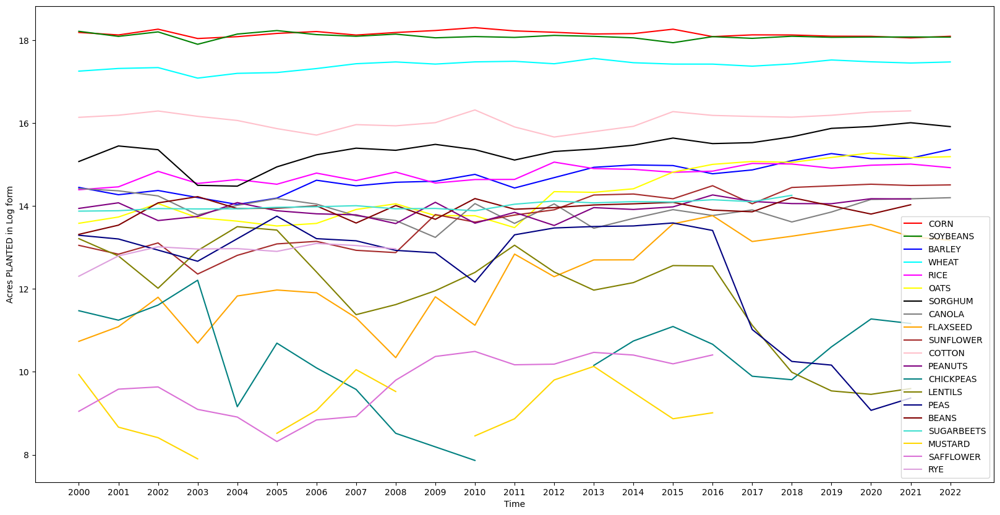

In [15]:
plotter(cropOutput_1) ## Plotter

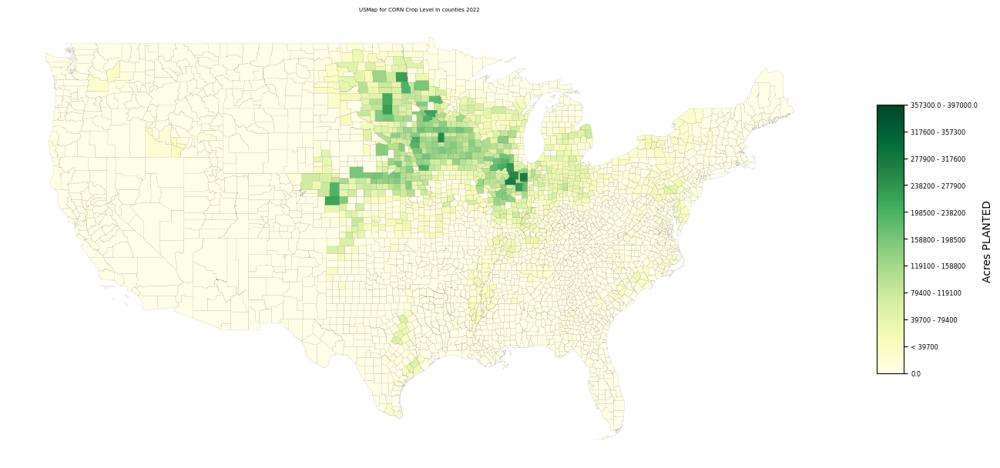

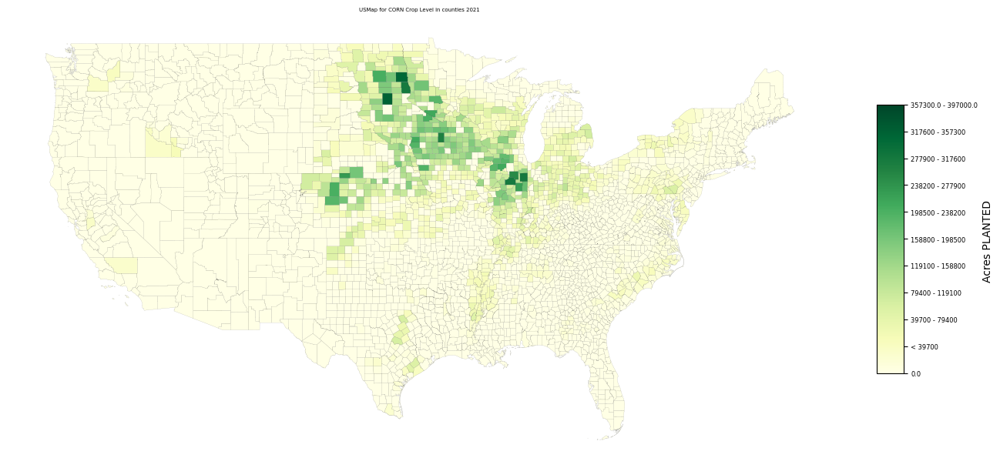

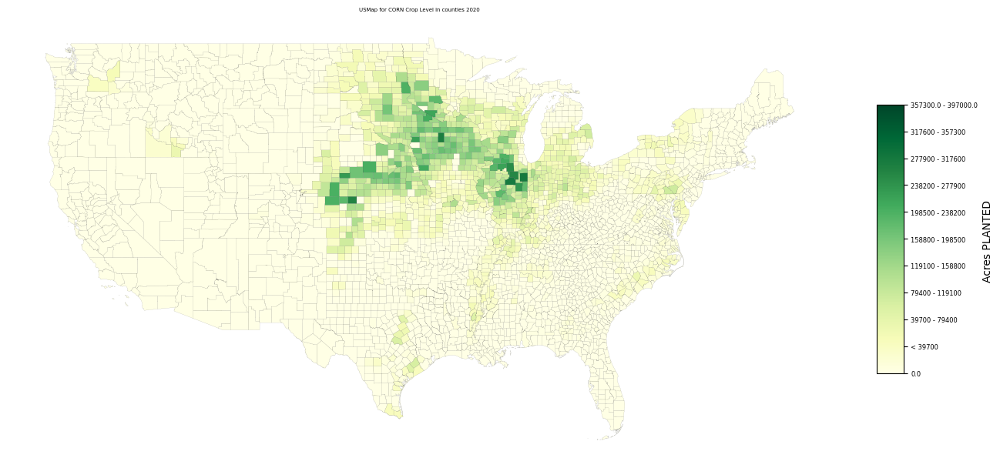

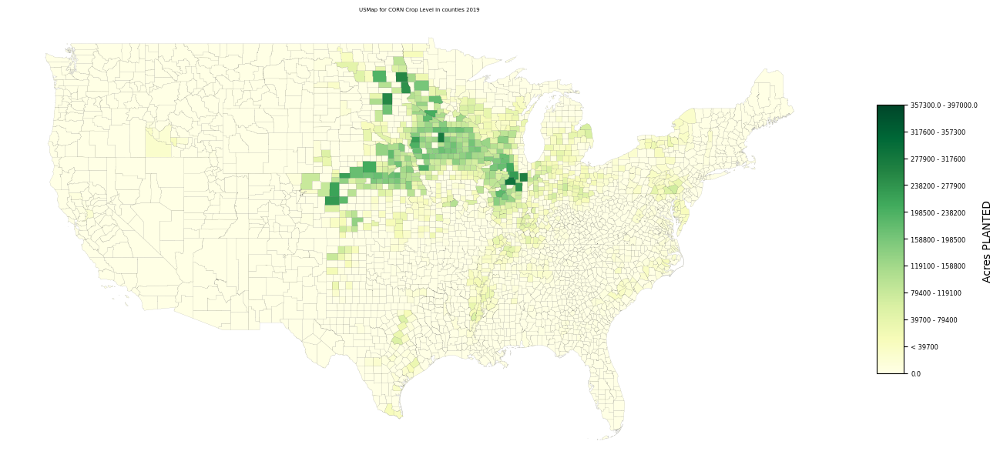

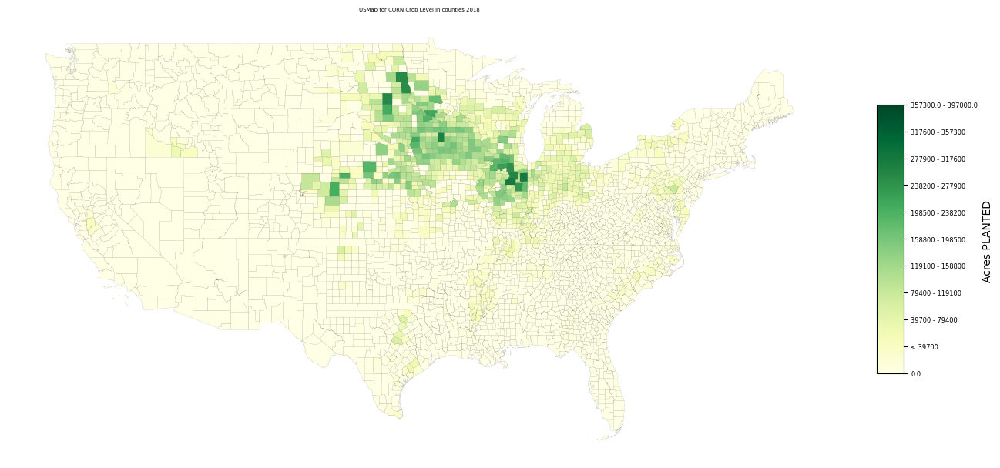

...

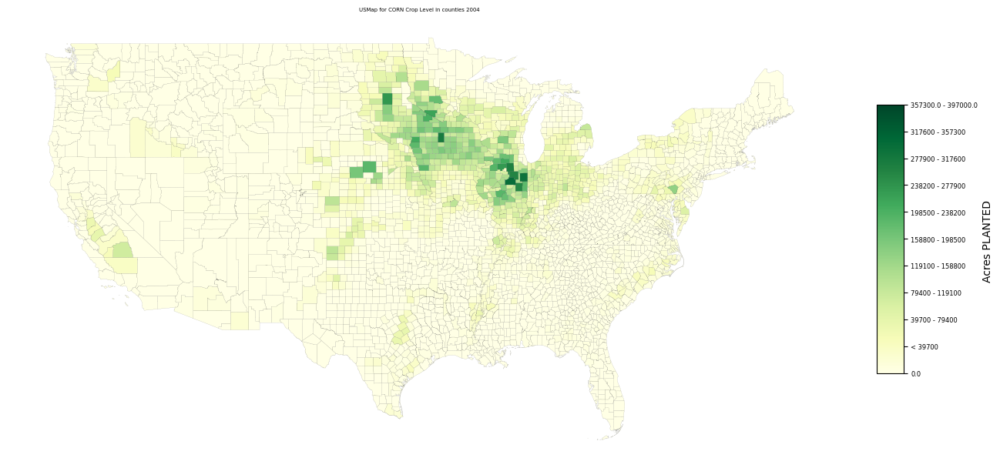

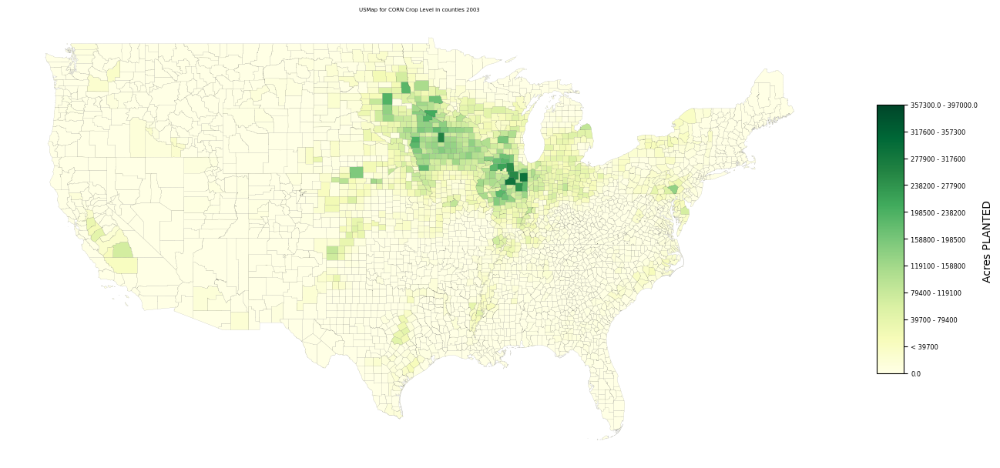

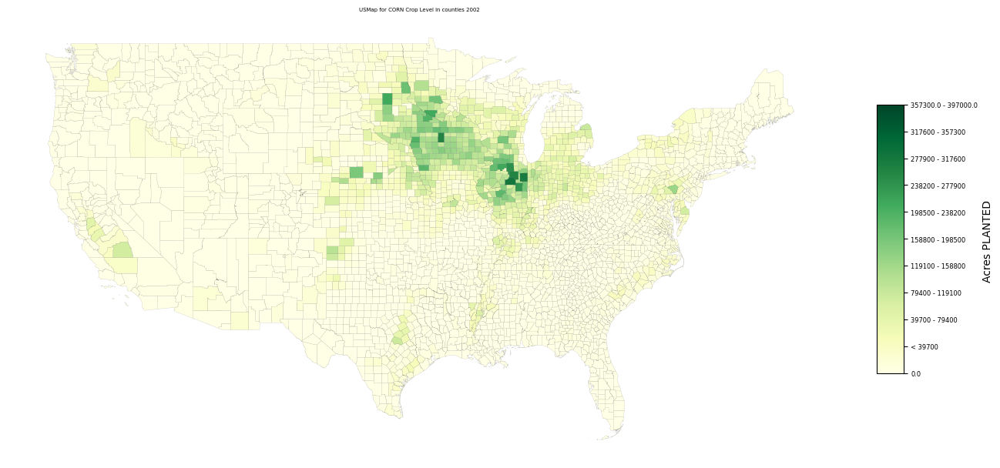

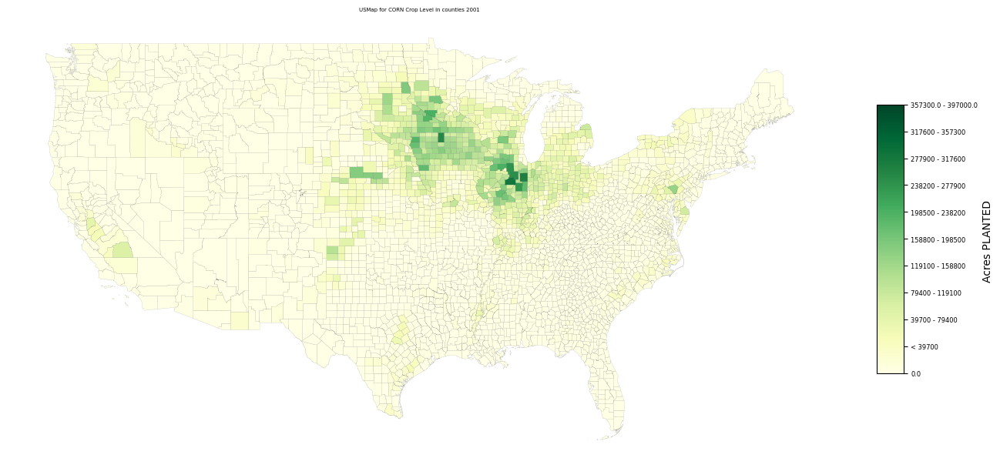

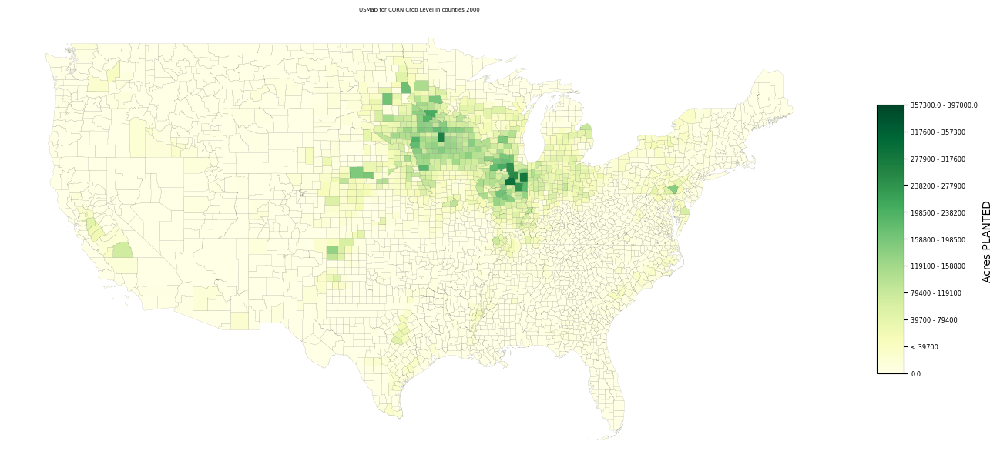

In [58]:
cropsepMapper(cropOutput_1,0) ## generates maps for crop with idex 0 (Corn) over all years (in multiple panels)

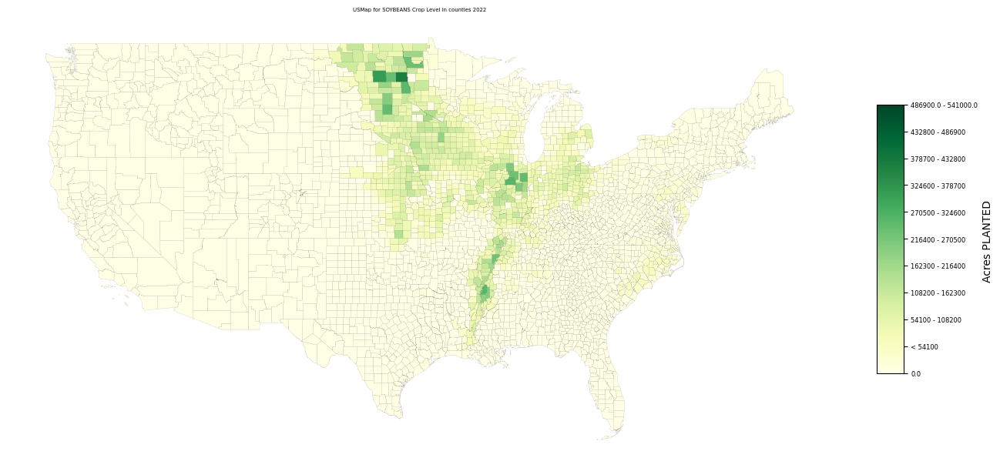

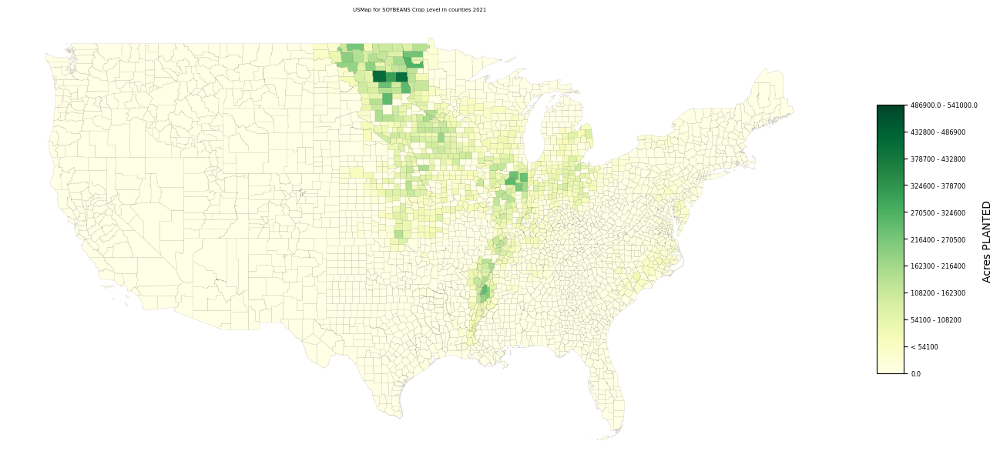

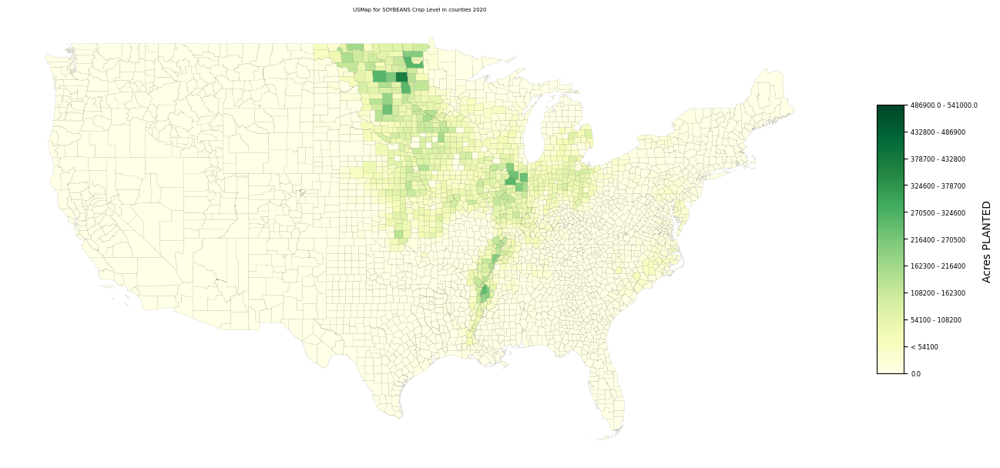

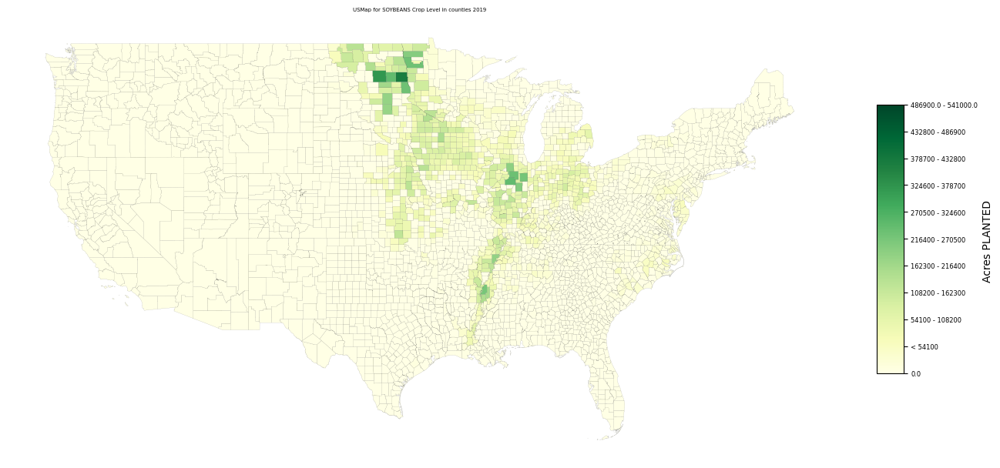

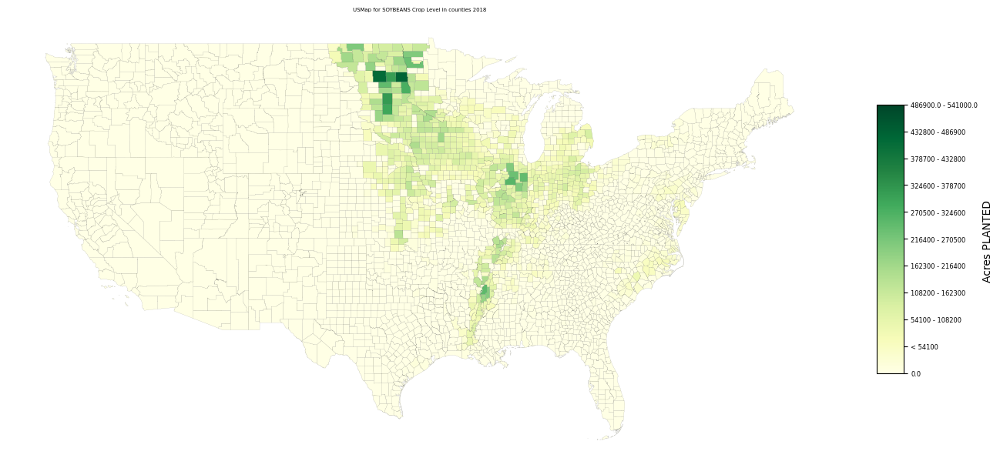

...

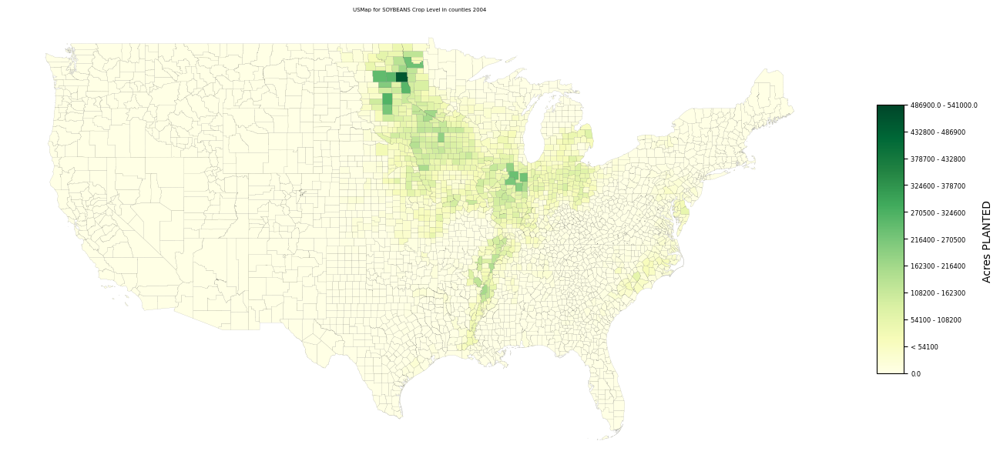

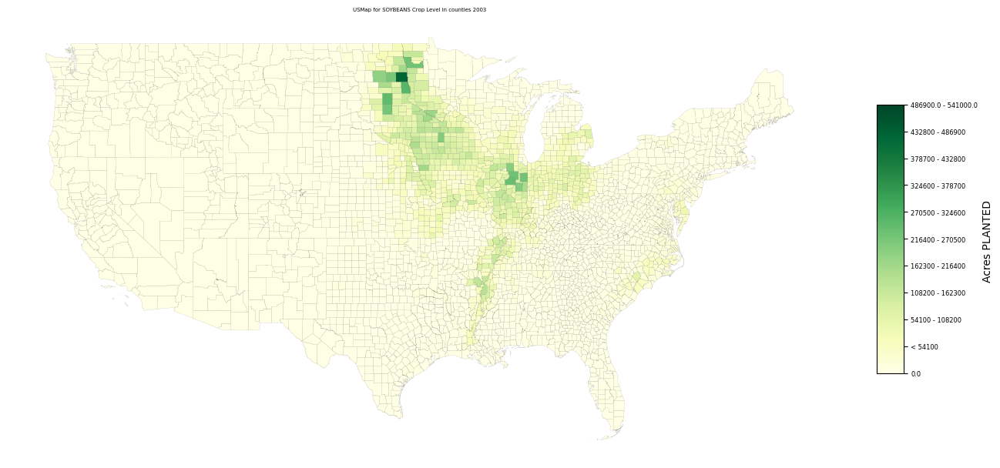

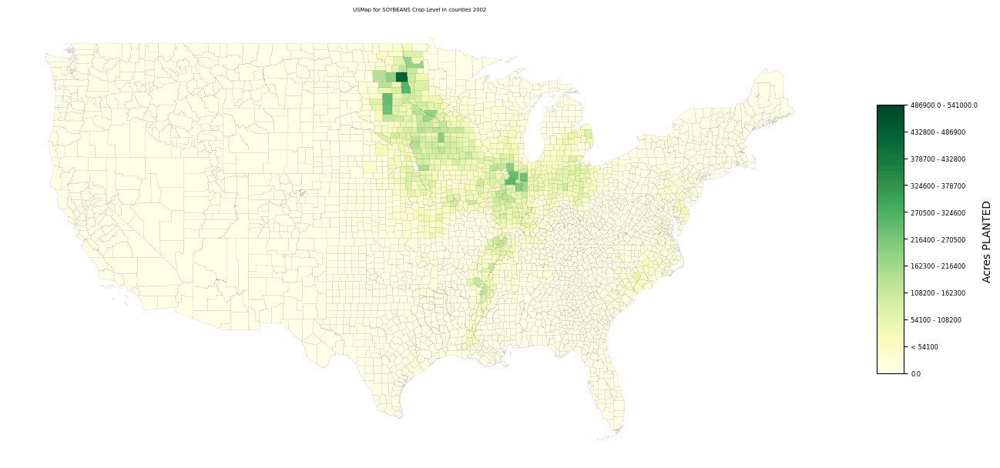

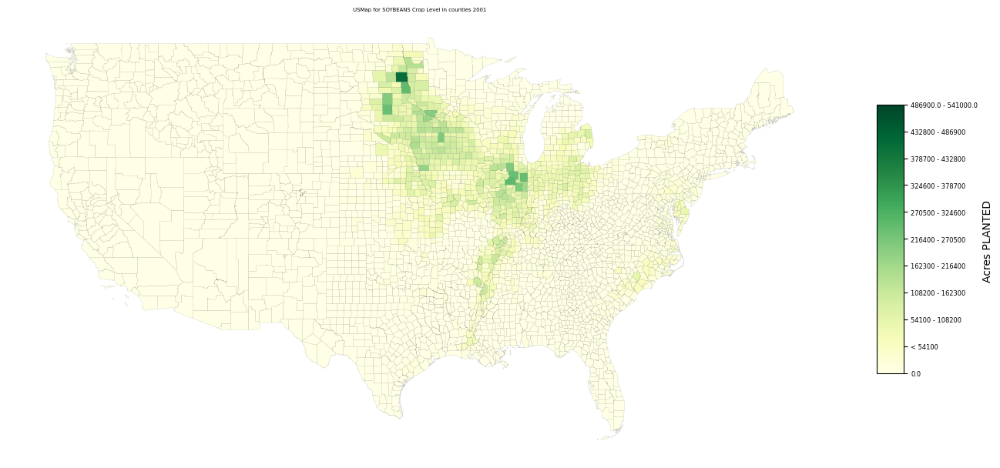

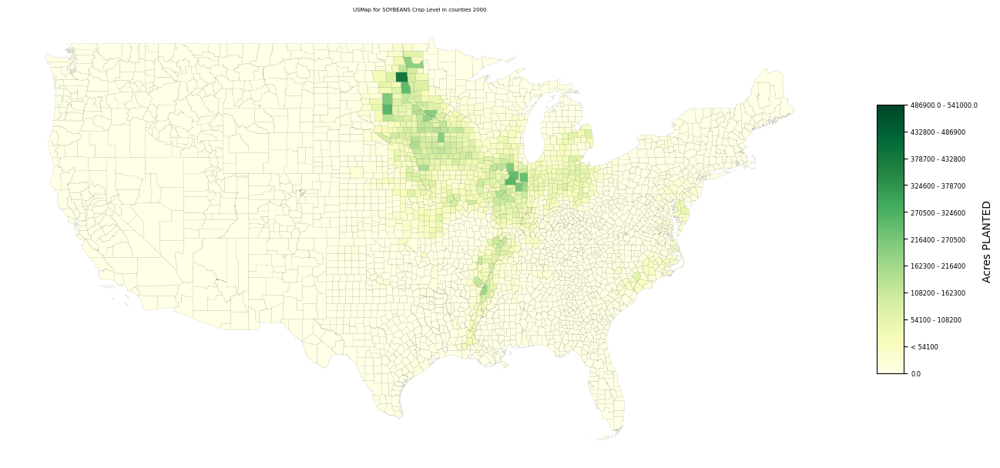

In [59]:
cropsepMapper(cropOutput_1,1) ## generates maps for crop with idex 1 (Soybeans) over all years (in multiple panels)


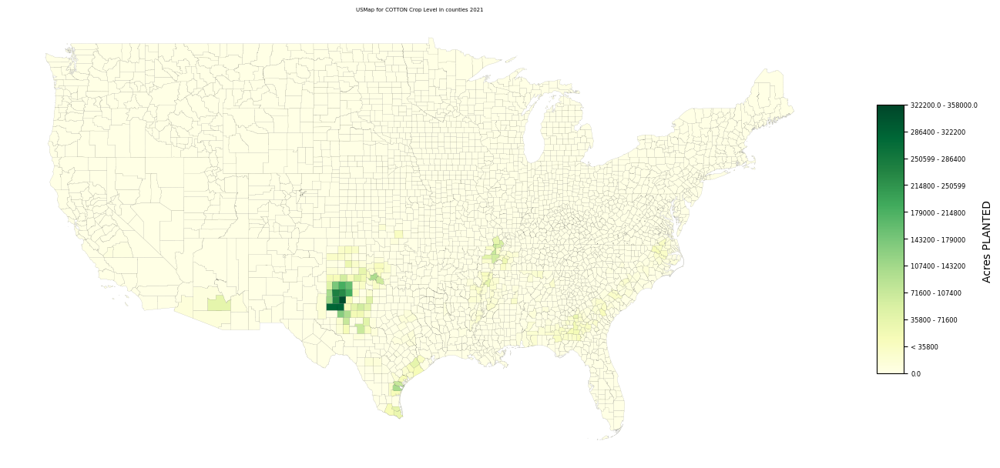

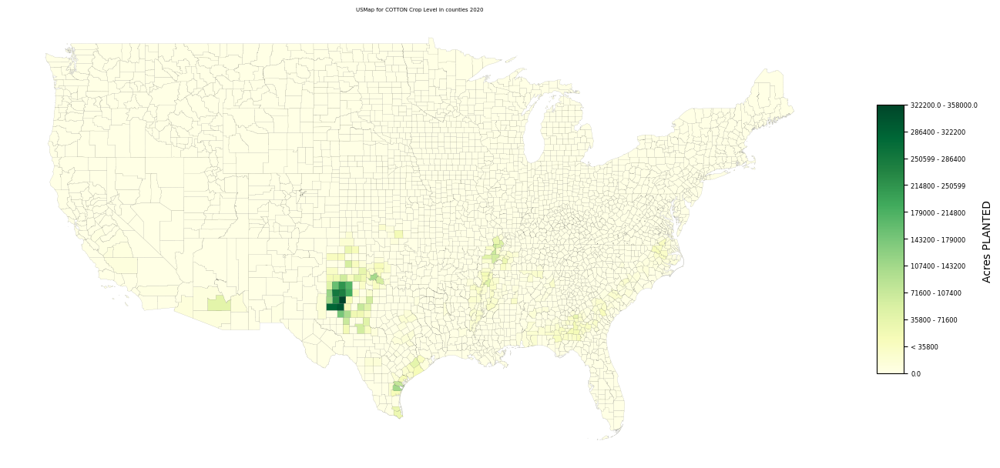

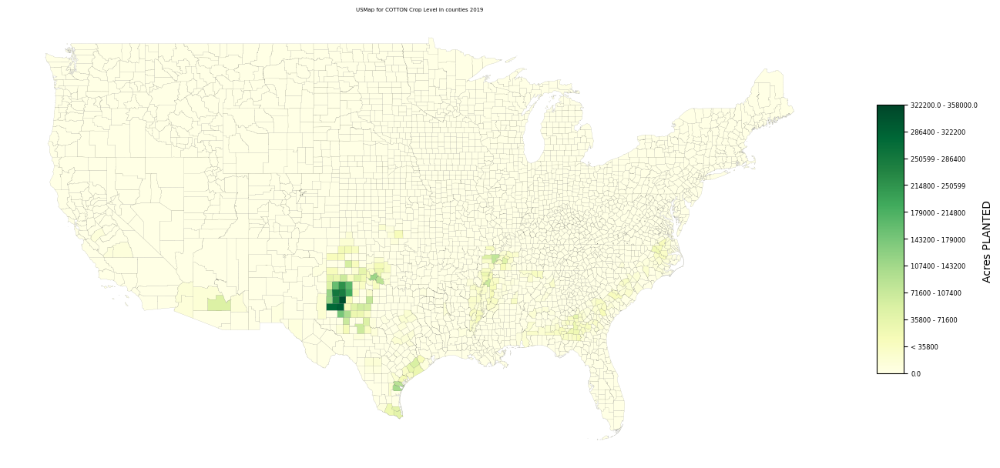

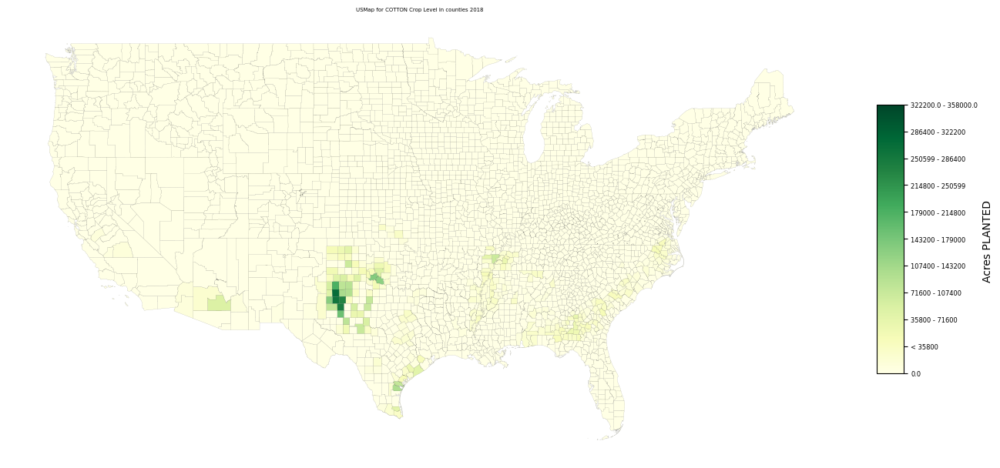

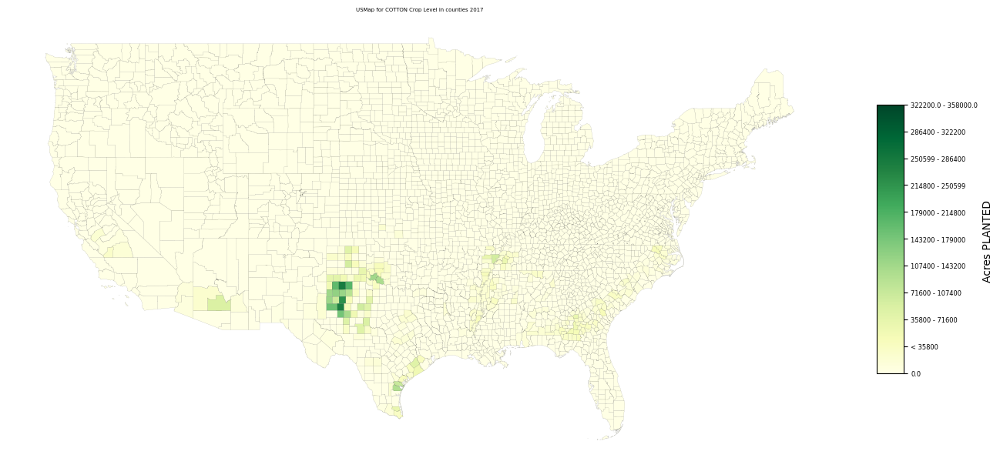

...

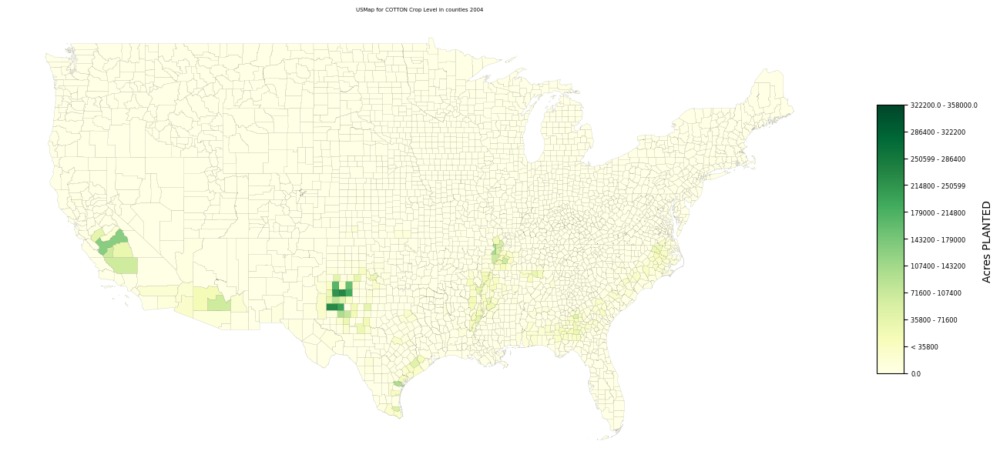

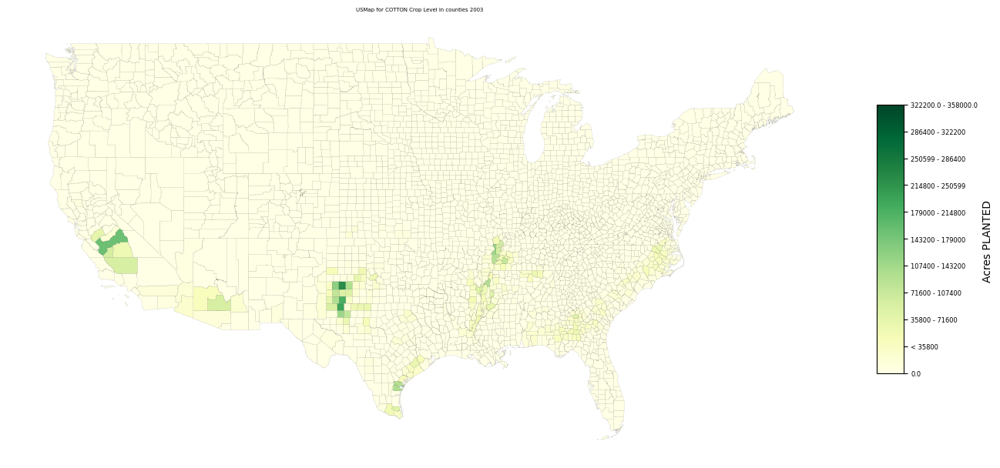

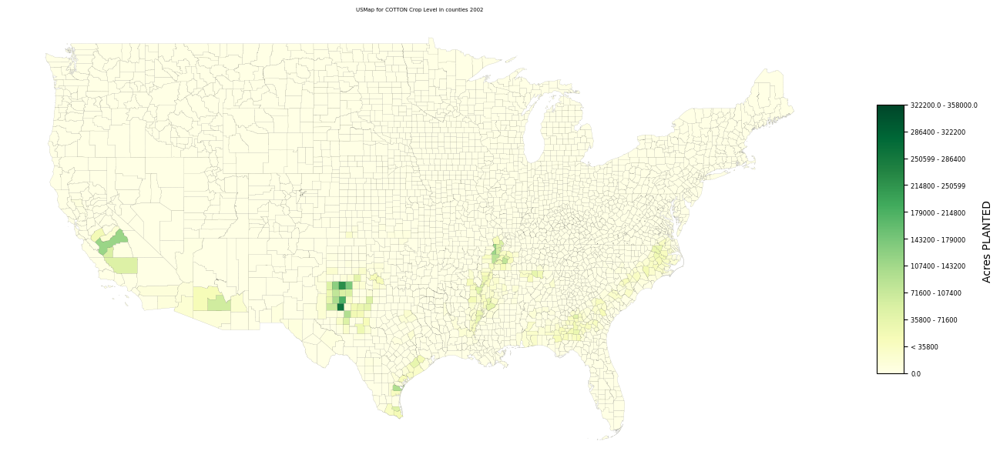

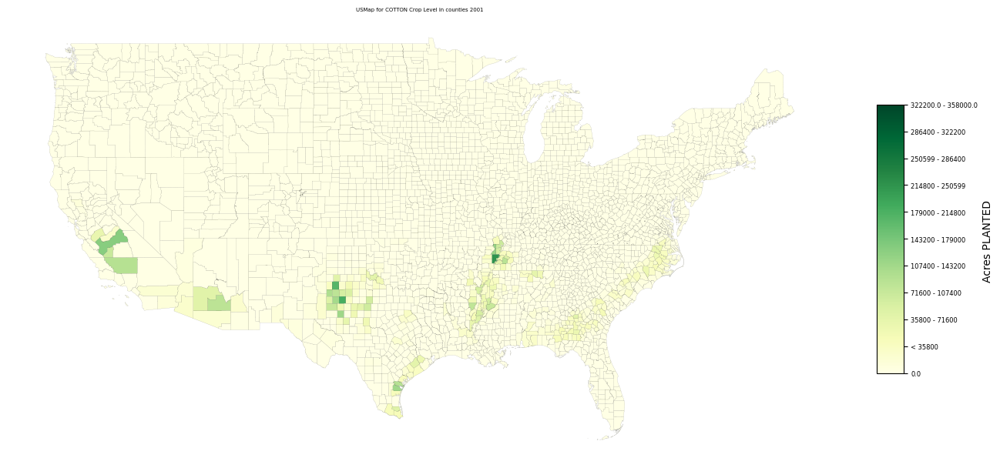

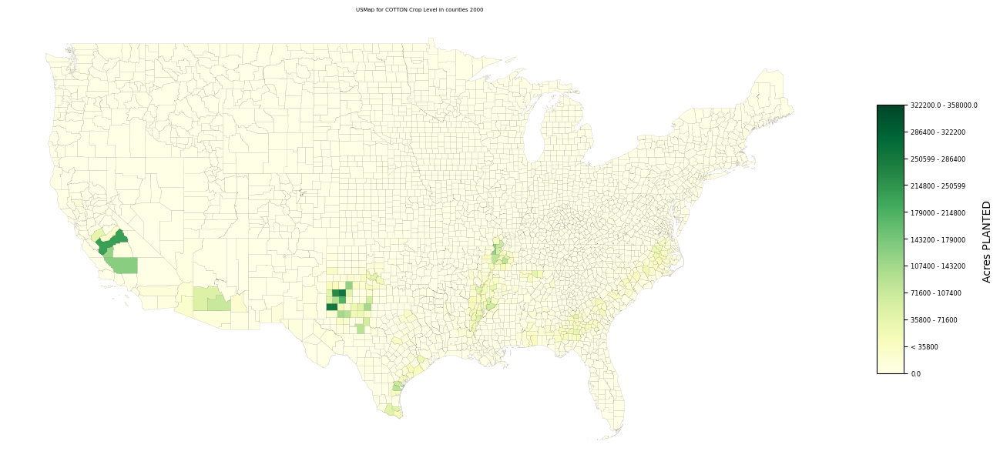

In [60]:
cropsepMapper(cropOutput_1,10) ## generates maps for crop with idex 10 (Cotton) over all years (in multiple panels)

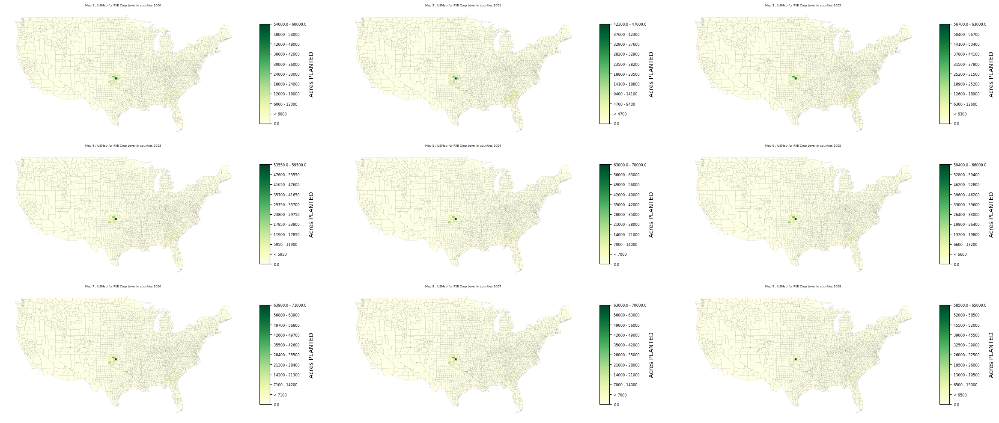

In [54]:
cropmultiMapper(cropOutput_1,3,3,19 ) ## generates maps for crop with index 19(RYE) over all years (in a single panel)

## Diversity Map of Example 1

In [73]:

# Suppress all warnings
warnings.filterwarnings("ignore")

DiversityMap_list_1 = diversityMapgenerator(cropOutput_1[0:8])  ## Make a diversity map for first 8 crops (i.e from Corn to Canola) 

# Restore default warning behavior
warnings.filterwarnings("default")


It is complete and you can compute the diversity map


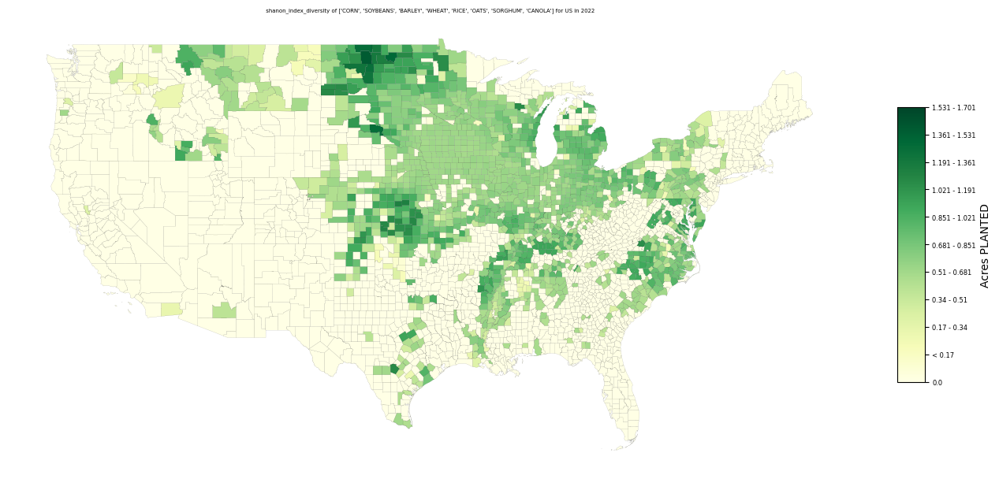

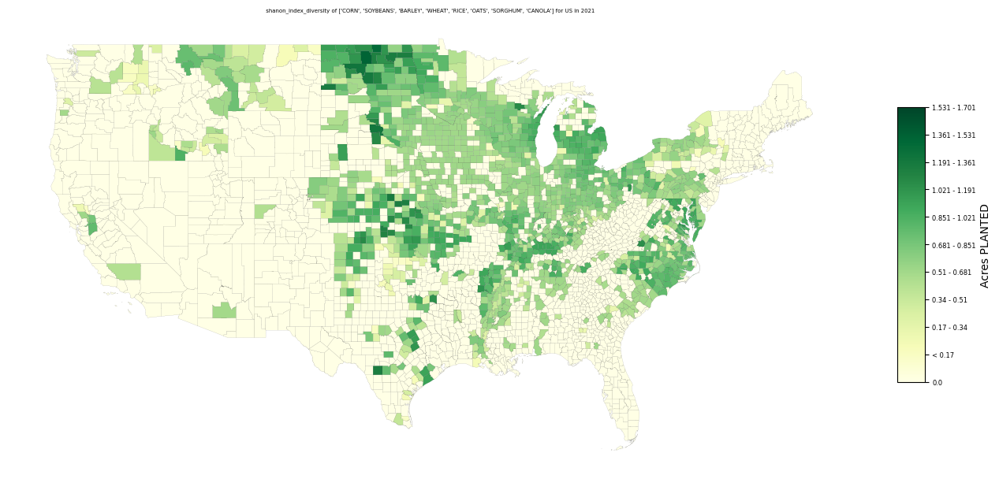

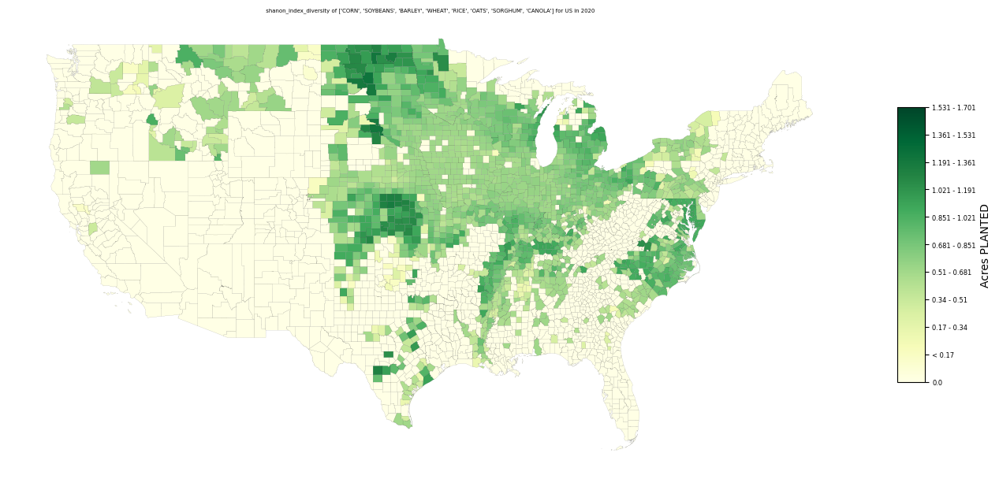

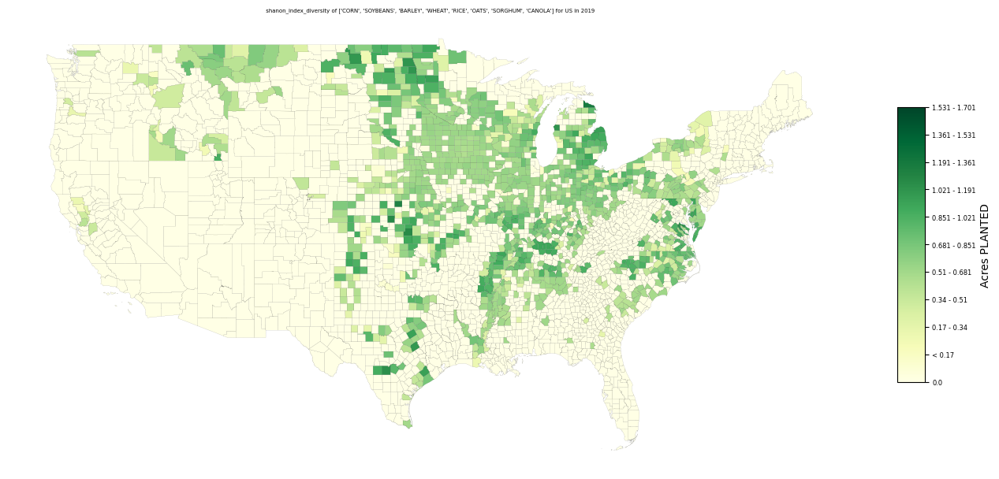

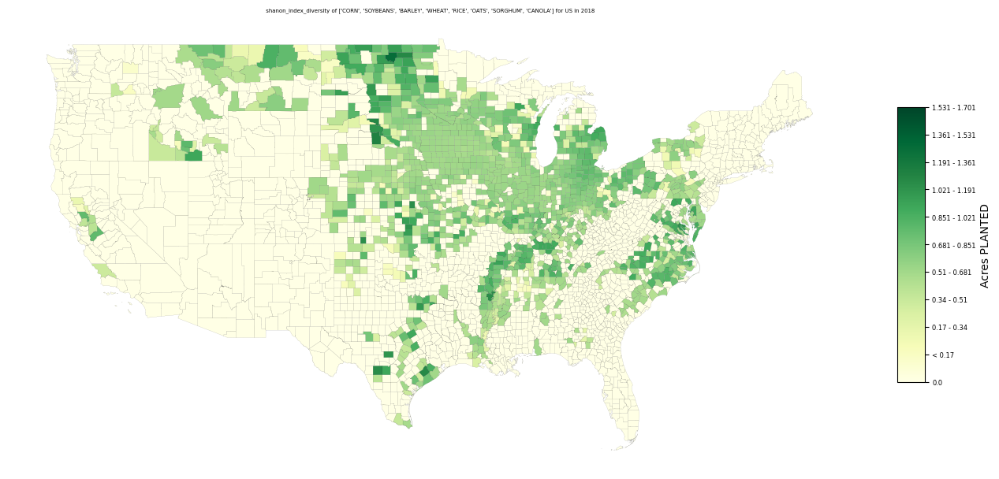

...

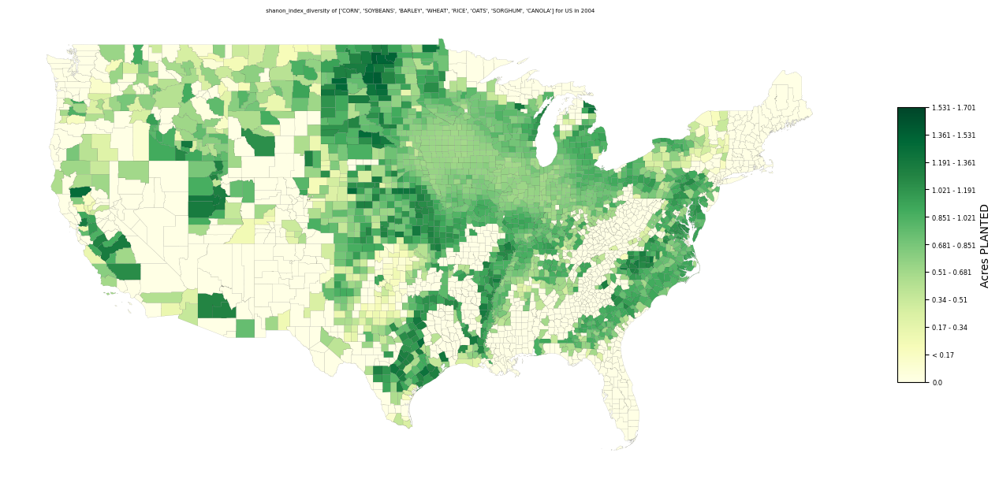

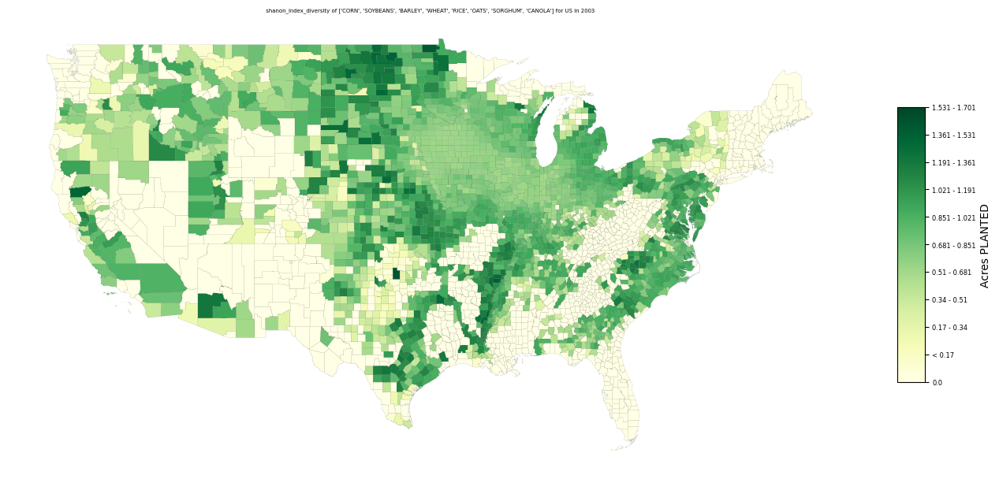

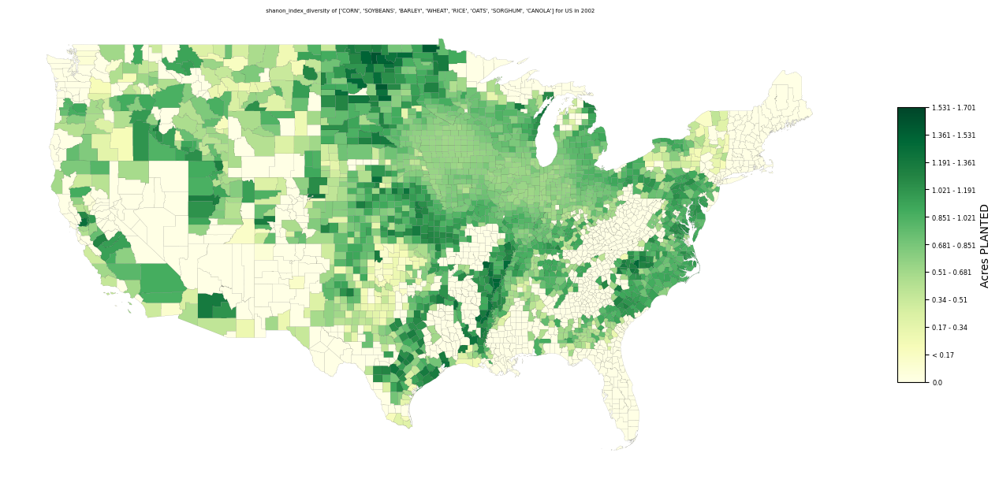

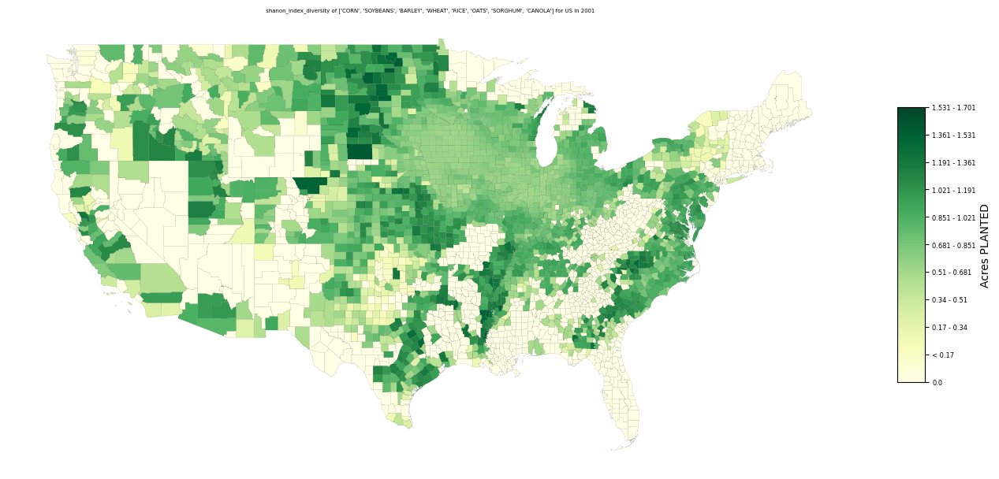

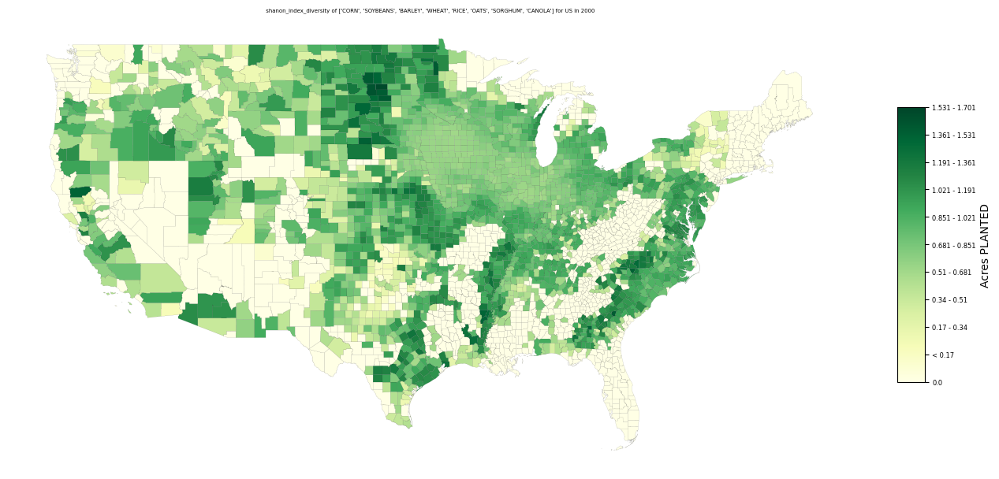

In [71]:
diversitysepMapper(DiversityMap_list_1,'shanon_index_diversity') ## genetates maps of shanon diversity over years (multiple panels)



As you see, the diversitymap_list_1 is from 2000 to 2022 which includes 23 maps. You can customize it to a single squared panel.For example, by following code,  you can just present 20 of them (from 2002 to 2022) in an squared single panel 

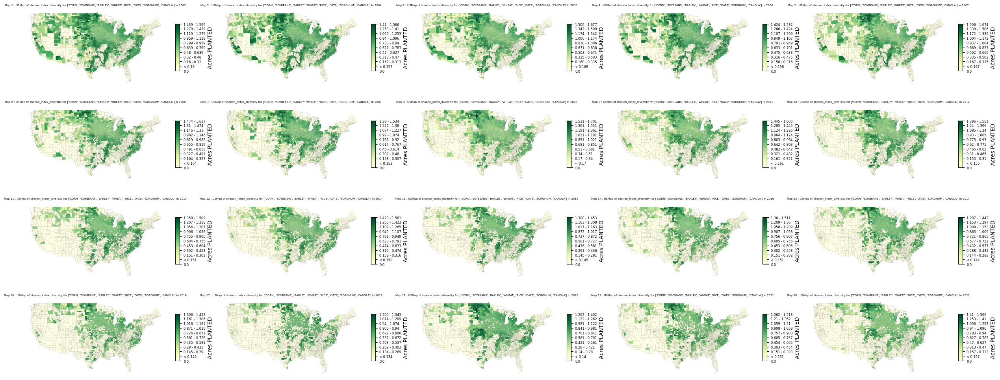

In [78]:
diversitymultiMapper(DiversityMap_list_1[:20],'shanon_index_diversity', 4,5)  ## (from 2002 to 2022) 

## Example 2: crops based on planted acres query and irrigated query

In [94]:
import warnings
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_2 = Algorithm(integratedCropData,USMap_edited ,'PLANTED','IRRIGATED') 
# Restore default warning behavior
warnings.filterwarnings("default")


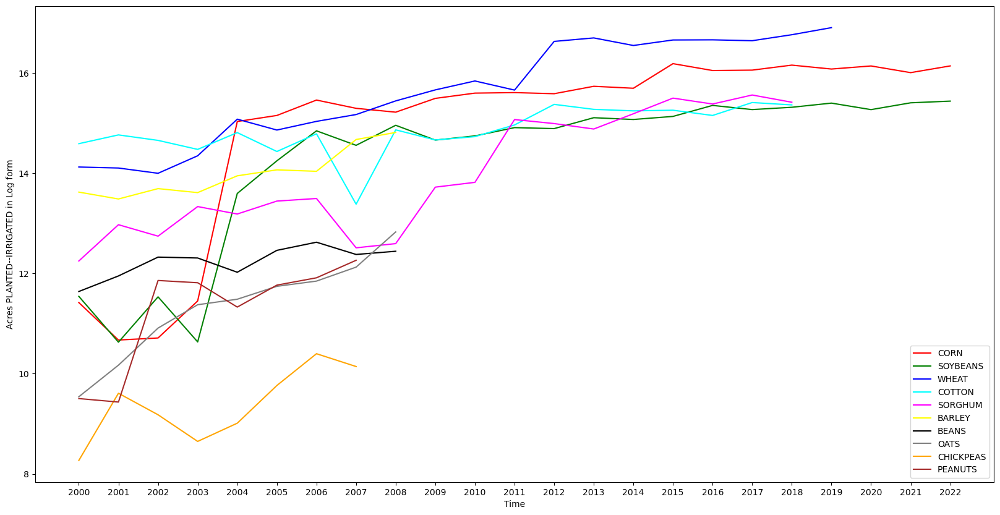

In [95]:
plotter(cropOutput_2) ## Plotter

## Example 3: crops based on planted acres query and non-irrigated query

In [96]:
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_3 = Algorithm(integratedCropData,USMap_edited ,'PLANTED','NON-IRRIGATED') 
# Restore default warning behavior
warnings.filterwarnings("default")

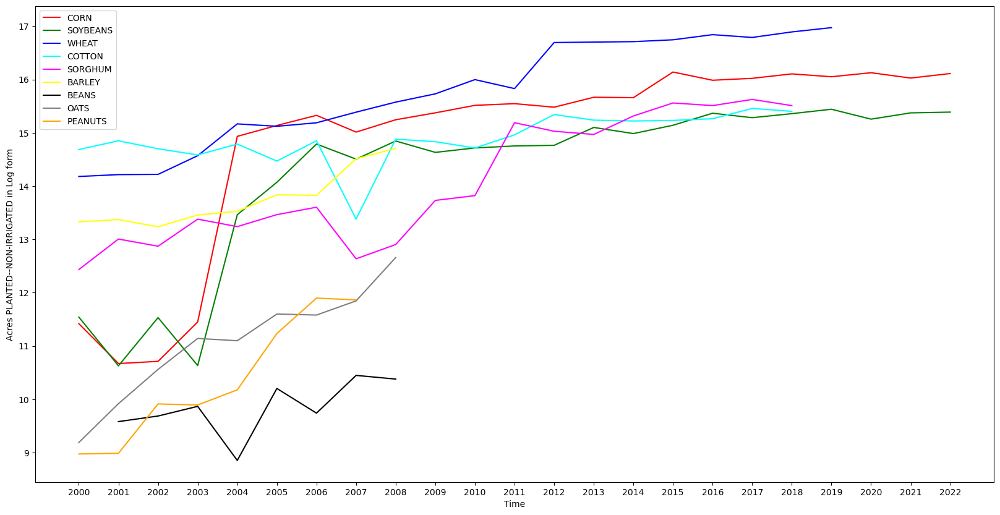

In [97]:
plotter(cropOutput_3) ## Plotter

## Example 4: crops based on harvested acres query and non-irrigated query

In [98]:
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_4 = Algorithm(integratedCropData,USMap_edited ,'HARVESTED','NON-IRRIGATED') 
# Restore default warning behavior
warnings.filterwarnings("default")

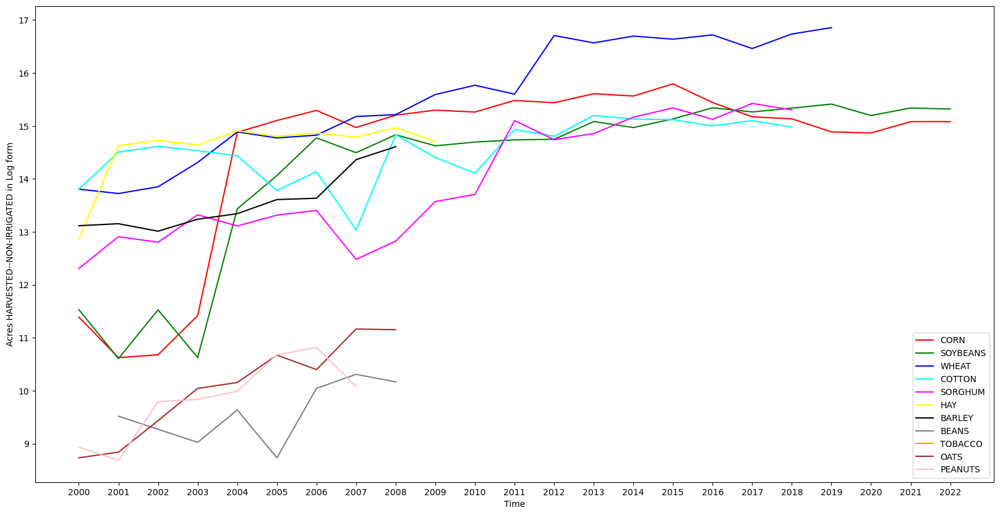

In [99]:
plotter(cropOutput_4) ## Plotter

## Example 5: crops based on Yeild query

In [100]:
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_5 = Algorithm(integratedCropData,USMap_edited ,'YIELD','') 
# Restore default warning behavior
warnings.filterwarnings("default")

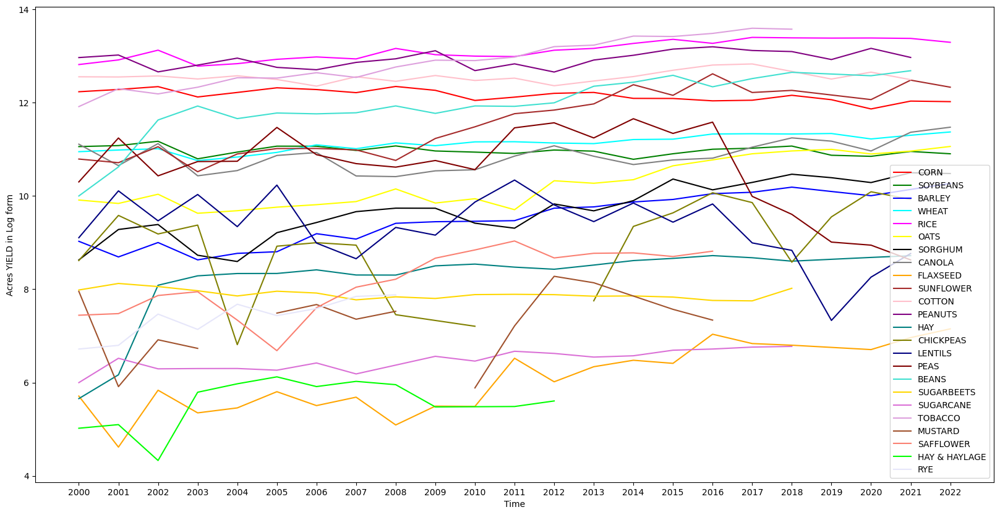

In [101]:
plotter(cropOutput_5) ## Plotter

## Example 6: crops based on Production query

In [102]:
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_6 = Algorithm(integratedCropData,USMap_edited ,'PRODUCTION','') 
# Restore default warning behavior
warnings.filterwarnings("default")

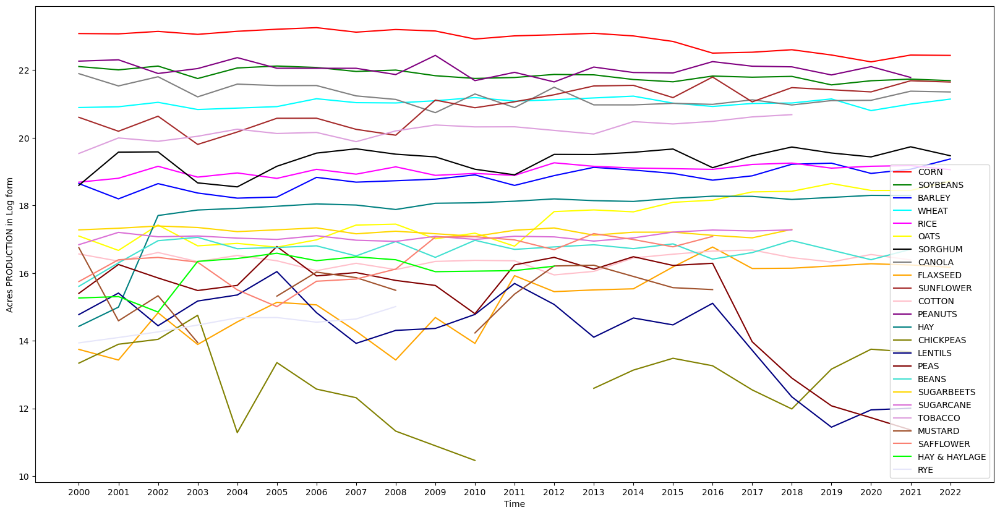

In [103]:
plotter(cropOutput_6) ## Plotter

## Example 7: crops based on Production query and "Measured in CWT" query

In [106]:
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_7 = Algorithm(integratedCropData,USMap_edited ,'PRODUCTION','MEASURED IN CWT')
# Restore default warning behavior
warnings.filterwarnings("default")

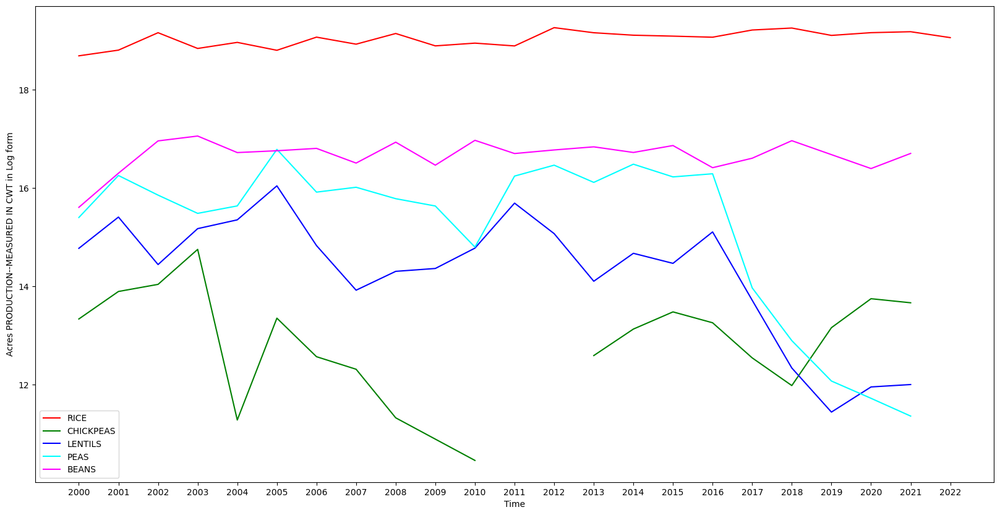

In [108]:
plotter(cropOutput_7) ## Plotter

## Example 8: crops based on Production query and "MEASURED IN TONS" query

In [109]:
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_8 = Algorithm(integratedCropData,USMap_edited ,'PRODUCTION','MEASURED IN TONS')
# Restore default warning behavior
warnings.filterwarnings("default")

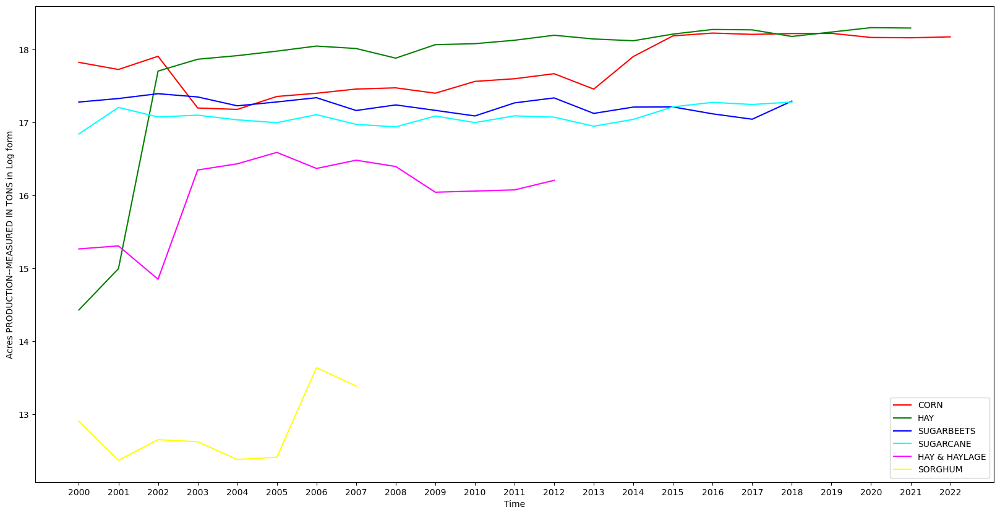

In [110]:
plotter(cropOutput_8) ## Plotter

## Example 9: crops based on Production query and "IN 480 LB BALES" query

In [113]:
# Suppress all warnings
warnings.filterwarnings("ignore")
cropOutput_9 = Algorithm(integratedCropData,USMap_edited ,'PRODUCTION','IN 480 LB BALES')
# Restore default warning behavior
warnings.filterwarnings("default")

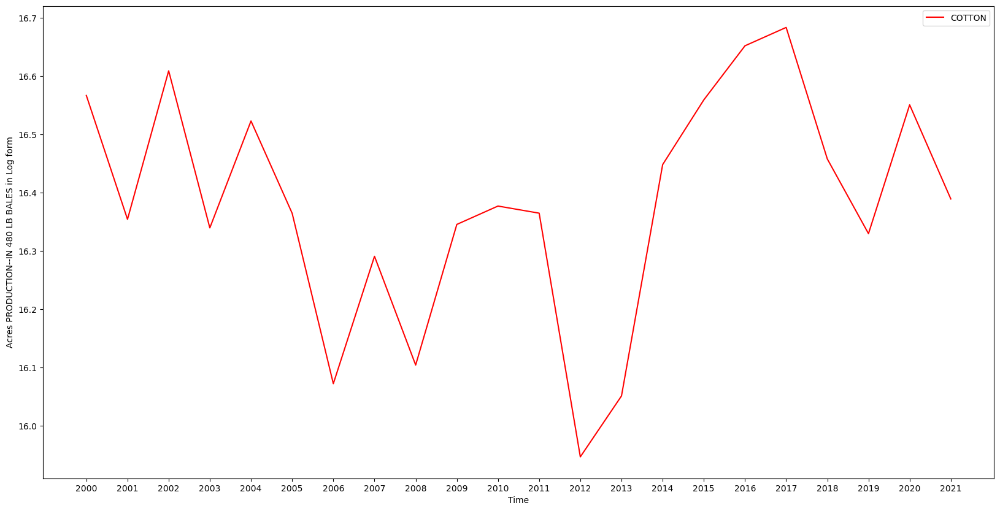

In [114]:
plotter(cropOutput_9) ## Plotter

**Since each element of output data structure is a geopanda dataframe, we can easily implement geopandas-specific methods on them**

In [155]:
print(f"Naumber of crops in cropOutput_9 is {len(cropOutput_9)}")
print(f"Naumber of years recorded for the crop is {len(cropOutput_9[0])}")

Naumber of crops in cropOutput_9 is 1
Naumber of years recorded for the crop is 22


<AxesSubplot:>

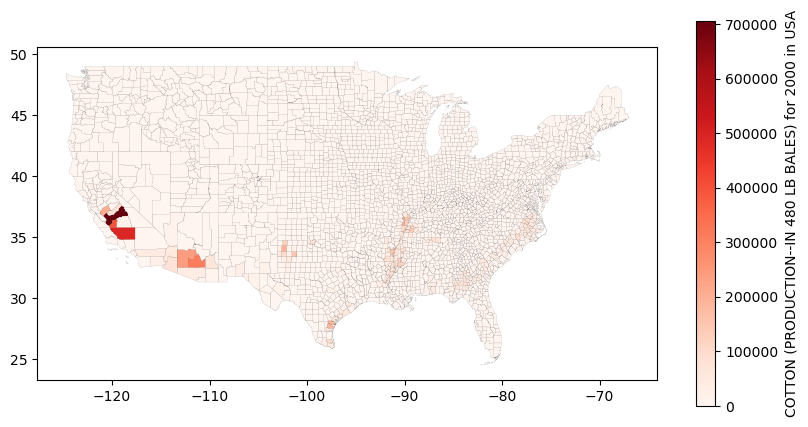

In [197]:
Crop_index = 0
Year_indices = list(range(0,22))
selected_year = Year_indices[21] ### since years are ascending, the last of year list is the year of 2000
cropOutput_9[Crop_index][selected_year].plot(column='Value', cmap='Reds', linewidth=0.05, edgecolor='black', legend=True, figsize=[10, 5], legend_kwds={'label': f"{cropOutput_9[Crop_index][selected_year].Commodity.values[0]} ({cropOutput_9[Crop_index][selected_year].QUERY.values[0]}) for {cropOutput_9[Crop_index][selected_year].Year.values[0]} in USA"})


<AxesSubplot:>

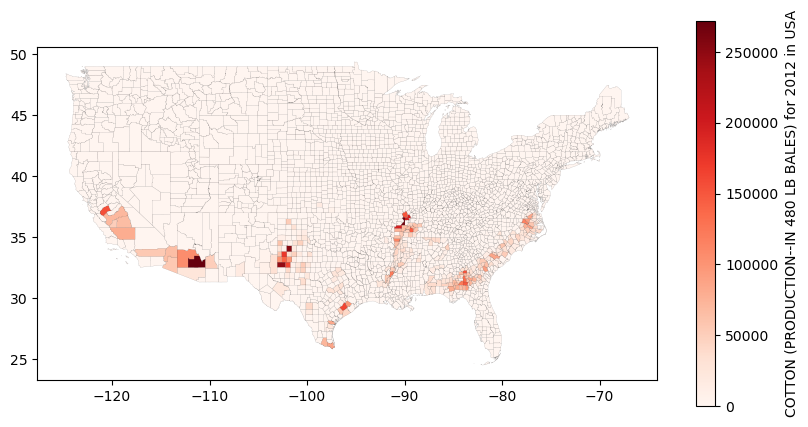

In [196]:
selected_year = Year_indices[9] ## for 2012
cropOutput_9[Crop_index][selected_year].plot(column='Value', cmap='Reds', linewidth=0.05, edgecolor='black', legend=True, figsize=[10, 5], legend_kwds={'label': f"{cropOutput_9[Crop_index][selected_year].Commodity.values[0]} ({cropOutput_9[Crop_index][selected_year].QUERY.values[0]}) for {cropOutput_9[Crop_index][selected_year].Year.values[0]} in USA"})


<AxesSubplot:>

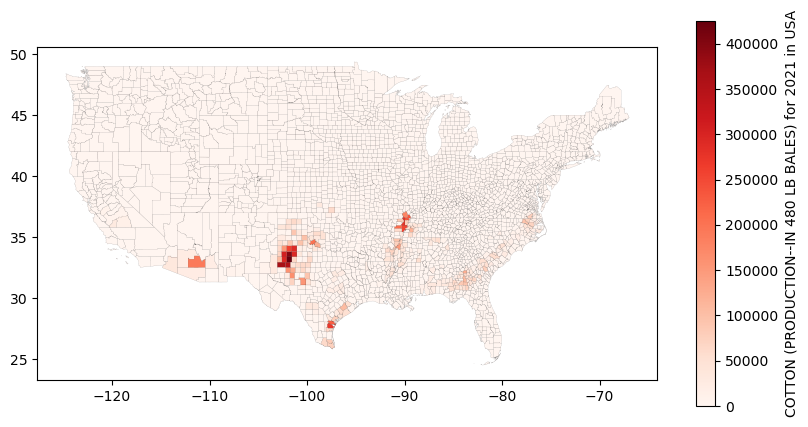

In [198]:
selected_year = Year_indices[0] ## for 2021
cropOutput_9[Crop_index][selected_year].plot(column='Value', cmap='Reds', linewidth=0.05, edgecolor='black', legend=True, figsize=[10, 5], legend_kwds={'label': f"{cropOutput_9[Crop_index][selected_year].Commodity.values[0]} ({cropOutput_9[Crop_index][selected_year].QUERY.values[0]}) for {cropOutput_9[Crop_index][selected_year].Year.values[0]} in USA"})


**We can dig much deeper and explore each state at county level**

In [185]:
## let explore the status of Cotton in Texas for year 2021
Texas_in_cropOutput_9 = cropOutput_9[0][0][cropOutput_9[0][0]['State'] == 'TEXAS']
Texas_in_cropOutput_9.head(25)

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,County,QUERY,ALAND,AWATER,geometry,Value,Commodity,Year,State
97,48,011,01383791,0500000US48011,48011,Armstrong,PRODUCTION--IN 480 LB BALES,2354581675,12219583,"POLYGON ((-101.62940 34.75006, -101.62806 34.8...",0.0,COTTON,2021,TEXAS
98,48,025,01383798,0500000US48025,48025,Bee,PRODUCTION--IN 480 LB BALES,2279809496,246409,"POLYGON ((-98.08976 28.66298, -98.00525 28.690...",34300.0,COTTON,2021,TEXAS
99,48,035,01383803,0500000US48035,48035,Bosque,PRODUCTION--IN 480 LB BALES,2545908079,50666115,"POLYGON ((-98.00068 32.02028, -97.99191 32.024...",0.0,COTTON,2021,TEXAS
100,48,053,01383812,0500000US48053,48053,Burnet,PRODUCTION--IN 480 LB BALES,2575134223,69922923,"POLYGON ((-98.45924 31.01038, -98.45874 31.011...",0.0,COTTON,2021,TEXAS
101,48,055,01383813,0500000US48055,48055,Caldwell,PRODUCTION--IN 480 LB BALES,1412150551,4973307,"POLYGON ((-97.89707 29.86437, -97.89615 29.870...",6200.0,COTTON,2021,TEXAS
102,48,083,01383827,0500000US48083,48083,Coleman,PRODUCTION--IN 480 LB BALES,3270933224,47963343,"POLYGON ((-99.72240 31.57608, -99.72170 31.576...",6400.0,COTTON,2021,TEXAS
193,48,103,01383837,0500000US48103,48103,Crane,PRODUCTION--IN 480 LB BALES,2033319700,1695980,"POLYGON ((-102.76769 31.63855, -102.76725 31.6...",0.0,COTTON,2021,TEXAS
194,48,141,01383855,0500000US48141,48141,El Paso,PRODUCTION--IN 480 LB BALES,2624139561,5451095,"POLYGON ((-106.64548 31.89867, -106.64084 31.9...",0.0,COTTON,2021,TEXAS
195,48,151,01383861,0500000US48151,48151,Fisher,PRODUCTION--IN 480 LB BALES,2328272101,7258480,"POLYGON ((-100.66061 32.53327, -100.66061 32.5...",62100.0,COTTON,2021,TEXAS
196,48,161,01383866,0500000US48161,48161,Freestone,PRODUCTION--IN 480 LB BALES,2273311881,36936952,"POLYGON ((-96.49671 31.79619, -96.45517 31.816...",0.0,COTTON,2021,TEXAS


<AxesSubplot:>

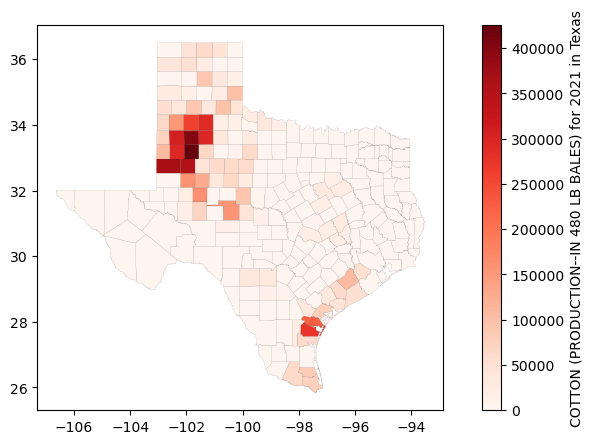

In [199]:
Texas_in_cropOutput_9.plot(column='Value', cmap='Reds', linewidth=0.05, edgecolor='black', legend=True, figsize=[10, 5], legend_kwds={'label': f"{Texas_in_cropOutput_9.Commodity.values[0]} ({Texas_in_cropOutput_9.QUERY.values[0]}) for {Texas_in_cropOutput_9.Year.values[0]} in Texas"})




In [ ]:
##let check the status of cotton in Bee County of texas for 2021

In [191]:
BeeCounty = Texas_in_cropOutput_9[Texas_in_cropOutput_9["County"] == "Bee"]
BeeCounty

,STATEFP,COUNTYFP,COUNTYNS,AFFGEOID,GEOID,County,QUERY,ALAND,AWATER,geometry,Value,Commodity,Year,State
98,48,025,01383798,0500000US48025,48025,Bee,PRODUCTION--IN 480 LB BALES,2279809496,246409,"POLYGON ((-98.08976 28.66298, -98.00525 28.690...",34300.0,COTTON,2021,TEXAS


<AxesSubplot:>

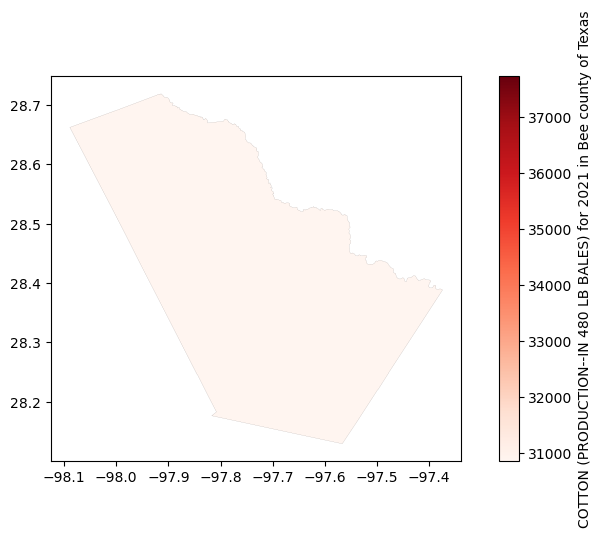

In [200]:
BeeCounty.plot(column='Value', cmap='Reds', linewidth=0.05, edgecolor='black', legend=True, figsize=[10, 5], legend_kwds={'label': f"{BeeCounty.Commodity.values[0]} ({BeeCounty.QUERY.values[0]}) for {BeeCounty.Year.values[0]} in Bee county of Texas"})


